In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import os
import pandas as pd
import numpy as np
from tqdm import tqdm
import scipy.ndimage as ndimage
from skimage.transform import resize

import GOES
import pyproj as pyproj
from pyresample import utils
from pyresample.geometry import SwathDefinition
from pyresample.kd_tree import resample_nearest
import concurrent.futures

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import VGG16
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.layers import Layer, UpSampling2D, BatchNormalization, SpatialDropout2D, Activation, Input, Dropout, Lambda, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, add, multiply, dot
from tensorflow.keras.models import Model

import datetime
import concurrent.futures

2024-07-14 15:58:50.427669: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
# dirpath = 'output_labeled_ARs/noaa-goes17/ABI-L1b-RadF'
# df = pd.DataFrame(columns=['year','day','hour','band','filepath'])

# for y in ['2018', '2020', '2022', '2019', '2021']:
#     print(y)
#     days = os.listdir(os.path.join(dirpath,y))
#     # print(os.listdir(os.path.join(dirpath,y)))
#     for d in tqdm(days):
#         hours = os.listdir(os.path.join(dirpath,y,d))
#         for h in hours:
#             files = os.listdir(os.path.join(dirpath,y,d,h))
#             for f in files:
#                 band = f.split('-')[-1].split('_')[0]
#                 filepath = os.path.join(dirpath, y, d, h, f)
#                 new_row = pd.DataFrame({'year':[y],'day':[d],'hour':[h],'band':[band],'filepath':[filepath]})
#                 df = pd.concat([df,new_row], ignore_index=True)

In [3]:
# df = df.sort_values(by=['year', 'day', 'hour', 'band'])
# df.to_csv('goes2go.csv', index=False)

In [4]:
root_dir = '/home/ayadav7/'
data_dir = os.path.join(root_dir, 'data')

In [81]:
count = 0
valid_files = []
for y in ['2018', '2019', '2020', '2021']:
    dirpath = os.path.join(data_dir,'goes_current',y)
    files = os.listdir(dirpath)
    for f in tqdm(files):
        ds = xr.open_dataset(os.path.join(dirpath, f))
        var = list(ds.data_vars)[7]
        data = np.array(ds[var])
        thr = np.isnan(data).sum()/data.size * 100
        if thr<5:
            count = count + 1
            valid_files.append(os.path.join(dirpath, f))
        del ds

100%|██████████| 105/105 [00:10<00:00, 10.44it/s]


In [82]:
pd.DataFrame({'filename':valid_files}).to_csv(os.path.join(data_dir,'valid_west_files.csv'),index=False)

In [9]:
df = pd.read_csv(os.path.join(data_dir,'valid_west_files.csv'))
df

,filename
0,/home/ayadav7/data/goes_current/2018/334_12_g1...
1,/home/ayadav7/data/goes_current/2018/334_0_g17.nc
2,/home/ayadav7/data/goes_current/2018/331_18_g1...
3,/home/ayadav7/data/goes_current/2018/334_6_g17.nc
4,/home/ayadav7/data/goes_current/2018/362_12_g1...
...,...
1706,/home/ayadav7/data/goes_current/2021/33_0_g17.nc
1707,/home/ayadav7/data/goes_current/2021/33_6_g17.nc
1708,/home/ayadav7/data/goes_current/2021/33_12_g17.nc
1709,/home/ayadav7/data/goes_current/2021/33_18_g17.nc


In [21]:
f = df.loc[100,'filename']

In [22]:
def get_month_from_day_of_year(day_of_year, year):
    date = datetime.datetime(year, 1, 1) + datetime.timedelta(days=day_of_year - 1)
    month = date.month
    return month

def day_of_year_to_timestep(day_of_year, hour, year):
    date = datetime.datetime(year, 1, 1) + datetime.timedelta(days=day_of_year - 1, hours=hour)
    start_of_month = datetime.datetime(year, date.month, 1)
    delta_hours = (date - start_of_month).total_seconds() / 3600
    time_step = int(delta_hours // 6)
    month = date.month  
    return time_step, month

In [23]:
f.split('/')[-2]

'2019'

In [24]:
sat_data_dir = os.path.join(data_dir,'goes_current')
mask_data_dir = os.path.join(data_dir,'labels_arhoades')
input_vars = [f'M6C{str(i).zfill(2)}' for i in range(1, 17)]
input_shape = (4441, 4996)
chunk_size = (512, 512)
overlap = 112
lat_range = (80, 0)
lon_range = (180, 270)
save_dir = 'preprocessed_data'

# Given dimensions and window size
M, N, C = 4441, 4996, 16  # Example dimensions
w = 896  # Window size
overlap = 112  # Desired overlap

# Calculate stride length
stride = w - overlap

# Calculate the new dimensions based on the stride
m = (M - w) // stride + 1
n = (N - w) // stride + 1
A = m * n

In [37]:
def normalize_matrix(matrix):
    min_val = np.nanmin(matrix)
    max_val = np.nanmax(matrix)
    normalized_matrix = (matrix - min_val) / (max_val - min_val)
    return normalized_matrix

In [45]:
def make_downscaled_input_data(filepath):
    print(f'starting {filepath}\n')
    # Start timing
    start_time = time.time()
    
    dataset = xr.open_dataset(filepath)
    lat = dataset['lat'].values
    lon = dataset['lon'].values
    variables = [var for var in dataset.data_vars if var not in ['lat', 'lon']]
    data_arrays = [dataset[var].values for var in variables]
    data_shape = data_arrays[0].shape
    for data in data_arrays:
        if data.shape != data_shape:
            raise ValueError("All variables must have the same shape.")
    
    downscaled_data_arrays = [resize(dataset[var].values, chunk_size, mode='reflect', anti_aliasing=True) for var in variables ]
    downscaled_data_arrays = [normalize_matrix(matrix) for matrix in downscaled_data_arrays]
    downscaled_data_arrays = [np.nan_to_num(matrix, nan=-1.0) for matrix in downscaled_data_arrays]
    X = np.stack(downscaled_data_arrays, axis=-1) 
    
    # End timing
    end_time = time.time()
    
    # Print the time taken
    print(f"Time taken: {end_time - start_time:.6f} seconds")
    
    
    # Start timing
    start_time = time.time()
    
    year = filepath.split('/')[-2]
    filename = filepath.split('/')[-1]
    day = int(filename.split('_')[0])
    hour = int(filename.split('_')[1])
    ts, mo = day_of_year_to_timestep(day, hour, int(year))
    
    ld_files = [f for f in os.listdir(mask_data_dir) if year + str(mo).zfill(2) in f and 'nff' not in f]
    if len(ld_files) > 0:
        ld = xr.open_dataset(os.path.join(mask_data_dir, ld_files[0]))
        ld = ld.sel(latitude=slice(*lat_range), longitude=slice(*lon_range))
        data = ld['AR_binary_tag'][ts, :, :].values
        ld.close()
    
        binary_mask = data.astype(float)
        sigma = 5
        smoothed_mask = ndimage.gaussian_filter(binary_mask, sigma=sigma)
        combined_mask = np.where(data == 1, 1, smoothed_mask)
        combined_mask = np.where(combined_mask > 0.25, 1, combined_mask)
    
        y = resize(combined_mask, chunk_size, mode='reflect', anti_aliasing=True)
    else:
        y = np.zeros(w, w)
        
    
    # End timing
    end_time = time.time()
    
    # Print the time taken
    print(f"Time taken: {end_time - start_time:.6f} seconds")

    # Save the processed chunks
    save_path_X = os.path.join(root_dir, 'downscaled_data', f"X_{year}_{filename}.npy")
    save_path_y = os.path.join(root_dir, 'downscaled_data', f"y_{year}_{filename}.npy")
    np.save(save_path_X, X)
    np.save(save_path_y, y)
    print(f'ending {filepath}\n')

In [46]:
filepaths = []
for i in df.loc[:,'filename']:
    year, file = i.split('/')[-2],i.split('/')[-1]
    fname = f'X_{year}_{file}.npy'
    fname2 = f'y_{year}_{file}.npy'
    if fname not in os.listdir(os.path.join(root_dir,'downscaled_data')) or fname2 not in os.listdir(os.path.join(root_dir,'downscaled_data')):
        filepaths.append(i)

print(len(filepaths))

1711


In [ ]:
start_time = time.time()

# fileapths =  ['/home/ayadav7/data/goes_current/2018/334_12_g17.nc']:  # Replace with your file path
with concurrent.futures.ProcessPoolExecutor(max_workers = 10) as executor:
    results = list(executor.map(make_downscaled_input_data, filepaths))

end_time = time.time()
    
# Print the time taken
print(f"Time taken: {end_time - start_time:.6f} seconds")

starting /home/ayadav7/data/goes_current/2018/334_12_g17.nc

starting /home/ayadav7/data/goes_current/2018/331_18_g17.nc
starting /home/ayadav7/data/goes_current/2018/334_0_g17.nc
starting /home/ayadav7/data/goes_current/2018/334_6_g17.nc
starting /home/ayadav7/data/goes_current/2018/362_12_g17.nc




starting /home/ayadav7/data/goes_current/2018/363_0_g17.nc
starting /home/ayadav7/data/goes_current/2018/362_18_g17.nc
starting /home/ayadav7/data/goes_current/2018/363_6_g17.nc
starting /home/ayadav7/data/goes_current/2018/363_18_g17.nc
starting /home/ayadav7/data/goes_current/2018/363_12_g17.nc





Time taken: 13.683445 seconds
Time taken: 0.124131 seconds
ending /home/ayadav7/data/goes_current/2018/363_6_g17.nc

starting /home/ayadav7/data/goes_current/2018/364_6_g17.nc

Time taken: 14.000697 seconds
Time taken: 0.036767 seconds
Time taken: 14.048476 seconds
Time taken: 14.058564 seconds
Time taken: 14.079318 seconds
ending /home/ayadav7/data/goes_current/2018/334_12_g17.nc

Time take

starting /home/ayadav7/data/goes_current/2019/133_6_g17.nc

Time taken: 13.777975 seconds
Time taken: 0.029082 seconds


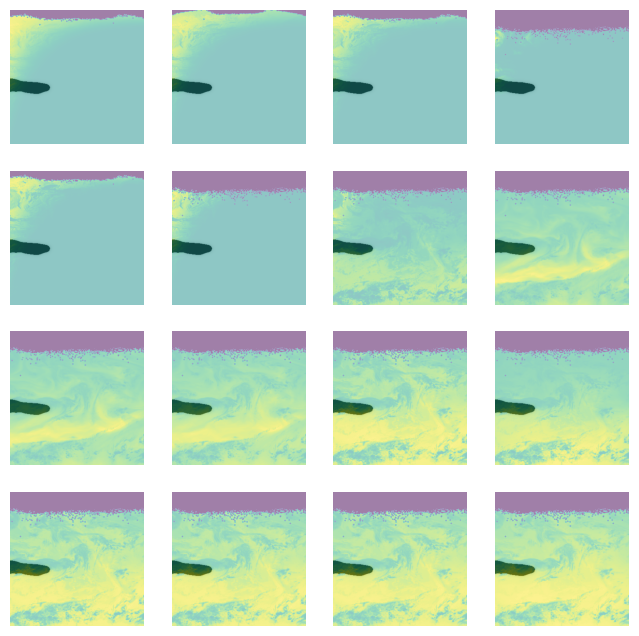

In [42]:
X, y = make_downscaled_input_data(f)
fig, ax = plt.subplots(4,4,figsize=(8,8))

k = 0
for i in range(4):
    for j in range(4):
        ax[i,j].imshow(X[:,:,k])
        ax[i,j].imshow(y[:,:],alpha=0.5,cmap='Grays')
        ax[i,j].axis('off')
        k = k + 1
plt.show()

In [13]:
import time

In [10]:
 
def make_input_data(filepath):
    print(f'starting {filepath}\n')
    # Start timing
    start_time = time.time()
    
    dataset = xr.open_dataset(filepath)
    lat = dataset['lat'].values
    lon = dataset['lon'].values
    variables = [var for var in dataset.data_vars if var not in ['lat', 'lon']]
    data_arrays = [dataset[var].values for var in variables]
    data_shape = data_arrays[0].shape
    for data in data_arrays:
        if data.shape != data_shape:
            raise ValueError("All variables must have the same shape.")
    combined_data = np.stack(data_arrays, axis=-1)
    
    downscaled_full_image = resize(dataset[list(dataset.data_vars)[7]].values, chunk_size, mode='reflect', anti_aliasing=True)
    downscaled_full_image = np.nan_to_num(downscaled_full_image, nan=0.0)
    x17 = np.expand_dims(np.tile(downscaled_full_image, (A, 1, 1)), axis=-1)
    dataset.close()

    blocks_list_comprehension = [
        combined_data[i:i + w, j:j + w, :]
        for i in range(0, M - w + 1, stride)
        for j in range(0, N - w + 1, stride)
    ]
    X = np.array(blocks_list_comprehension).reshape(A, w, w, C)
    X = np.concatenate((X, x17), axis=-1)

    # Create the location mask channel
    location_masks = []
    for i in range(0, M - w + 1, stride):
        for j in range(0, N - w + 1, stride):
            # Create a wxw mask
            mask = np.zeros((w, w), dtype=np.float32)
            # Calculate the start and end row/column for the window within the mask
            start_row = max(0, (i * w) // M)
            end_row = min(w, ((i + w) * w) // M)
            start_col = max(0, (j * w) // N)
            end_col = min(w, ((j + w) * w) // N)
            # Paint the window location with 1
            mask[start_row:end_row, start_col:end_col] = 1
            location_masks.append(mask)
    
    # Convert the location masks to the correct shape and concatenate
    location_masks = np.array(location_masks).reshape(A, w, w, 1)
    X = np.concatenate((X, location_masks), axis=-1)    
    
    # End timing
    end_time = time.time()

    # Print the time taken
    print(f"Time taken: {end_time - start_time:.6f} seconds")


    # Start timing
    start_time = time.time()
    
    year = filepath.split('/')[-2]
    filename = filepath.split('/')[-1]
    day = int(filename.split('_')[0])
    hour = int(filename.split('_')[1])
    ts, mo = day_of_year_to_timestep(day, hour, int(year))

    ld_files = [f for f in os.listdir(mask_data_dir) if year + str(mo).zfill(2) in f and 'nff' not in f]
    if len(ld_files) > 0:
        ld = xr.open_dataset(os.path.join(mask_data_dir, ld_files[0]))
        ld = ld.sel(latitude=slice(*lat_range), longitude=slice(*lon_range))
        data = ld['AR_binary_tag'][ts, :, :].values
        ld.close()

        binary_mask = data.astype(float)
        sigma = 20
        smoothed_mask = ndimage.gaussian_filter(binary_mask, sigma=sigma)
        combined_mask = np.where(data == 1, 1, 2 * smoothed_mask)
        combined_mask = np.where(combined_mask >= 1, 1, combined_mask)

        combined_mask_upscaled = resize(combined_mask, input_shape, mode='reflect', anti_aliasing=True)

        blocks_list_comprehension = [
            combined_mask_upscaled[i:i + w, j:j + w]
            for i in range(0, M - w + 1, stride)
            for j in range(0, N - w + 1, stride)
        ]
        y = np.array(blocks_list_comprehension).reshape(A, w, w, 1)
    else:
        y = np.zeros(A, w, w, 1)
        
    
    # End timing
    end_time = time.time()
    
    # Print the time taken
    print(f"Time taken: {end_time - start_time:.6f} seconds")

    # Save the processed chunks
    save_path_X = os.path.join(root_dir, save_dir, f"X_{year}_{filename}.npy")
    save_path_y = os.path.join(root_dir, save_dir, f"y_{year}_{filename}.npy")
    np.save(save_path_X, X)
    np.save(save_path_y, y)
    print(f'ending {filepath}\n')

In [11]:
filepaths = []
for i in df.loc[:,'filename']:
    year, file = i.split('/')[-2],i.split('/')[-1]
    fname = f'X_{year}_{file}.npy'
    fname2 = f'y_{year}_{file}.npy'
    if fname not in os.listdir(os.path.join(root_dir,'preprocessed_data')) or fname2 not in os.listdir(os.path.join(root_dir,'preprocessed_data')):
        filepaths.append(i)

print(len(filepaths))

515


In [13]:
start_time = time.time()

# fileapths =  ['/home/ayadav7/data/goes_current/2018/334_12_g17.nc']:  # Replace with your file path
with concurrent.futures.ProcessPoolExecutor(max_workers = 5) as executor:
    results = list(executor.map(make_input_data, filepaths))

end_time = time.time()
    
# Print the time taken
print(f"Time taken: {end_time - start_time:.6f} seconds")

starting /home/ayadav7/data/goes_current/2020/223_6_g17.nc
starting /home/ayadav7/data/goes_current/2020/223_12_g17.nc
starting /home/ayadav7/data/goes_current/2020/223_18_g17.nc
starting /home/ayadav7/data/goes_current/2020/224_12_g17.nc



starting /home/ayadav7/data/goes_current/2020/224_0_g17.nc


Time taken: 26.296852 secondsTime taken: 26.319814 seconds

Time taken: 2.073621 secondsTime taken: 2.082165 seconds

Time taken: 28.661999 seconds
Time taken: 29.593755 seconds
Time taken: 1.239014 seconds
Time taken: 1.287486 seconds
Time taken: 30.976329 seconds
Time taken: 1.257394 seconds
ending /home/ayadav7/data/goes_current/2020/223_6_g17.nc

starting /home/ayadav7/data/goes_current/2020/225_12_g17.nc

ending /home/ayadav7/data/goes_current/2020/223_18_g17.nc

starting /home/ayadav7/data/goes_current/2020/225_0_g17.nc

ending /home/ayadav7/data/goes_current/2020/223_12_g17.nc

starting /home/ayadav7/data/goes_current/2020/225_18_g17.nc

ending /home/ayadav7/data/goes_current/2020/

IndexError: range object index out of range

In [236]:
X = np.load(os.path.join(root_dir,'preprocessed_data/X_2018_364_6_g17.nc.npy'))
y = np.load(os.path.join(root_dir,'preprocessed_data/y_2018_364_6_g17.nc.npy'))

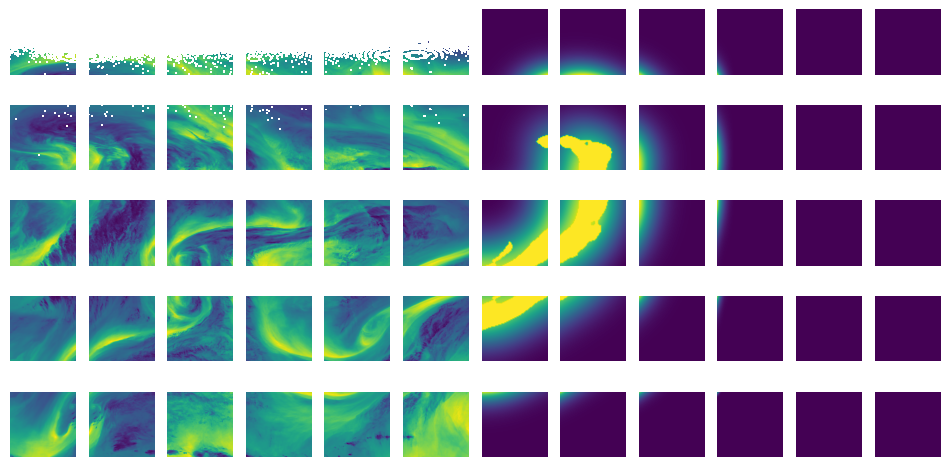

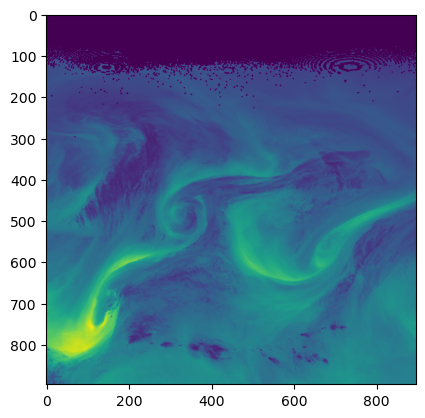

In [237]:
fig, ax = plt.subplots(5,12,figsize=(12,6))

k1 = 0
k2 = 0
for i in range(5):
    for j in range(6):
        ax[i,j].imshow(X[k1,:,:,7])
        k1 = k1 + 1
        ax[i,j].axis('off')

    for j in range(6,12):
        ax[i,j].imshow(y[k2,:,:,0])
        k2 = k2 + 1
        ax[i,j].axis('off')
plt.show()

plt.imshow(X[0,:,:,16])
plt.show()

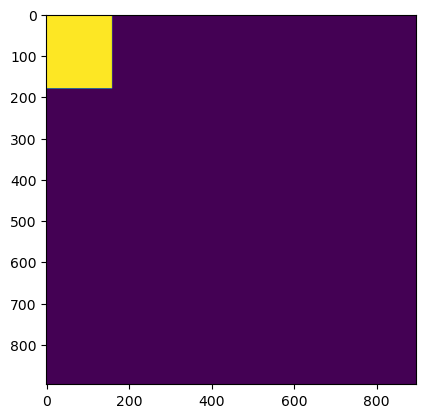

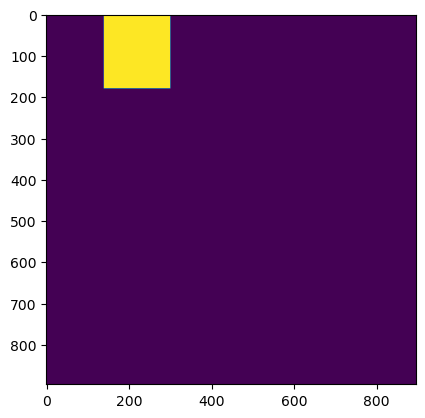

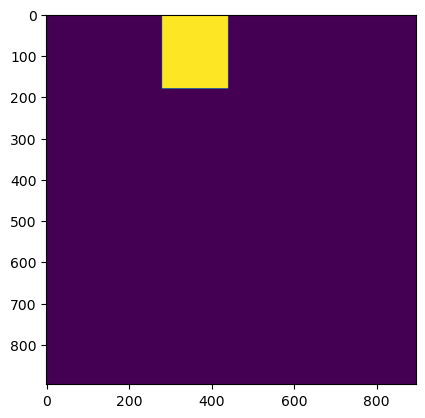

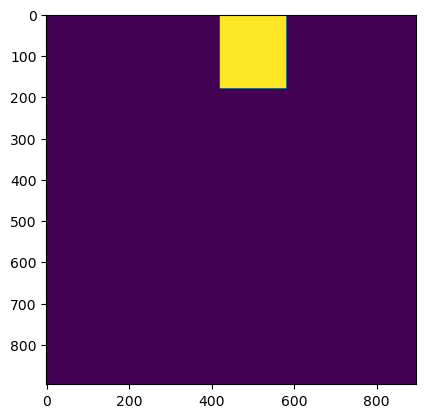

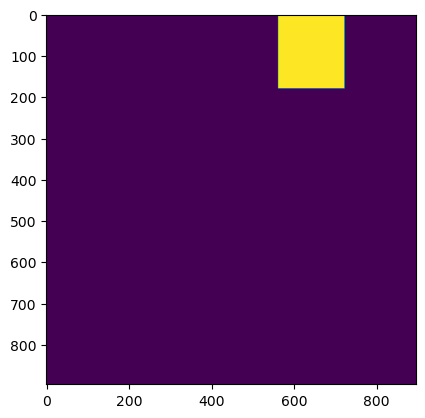

...

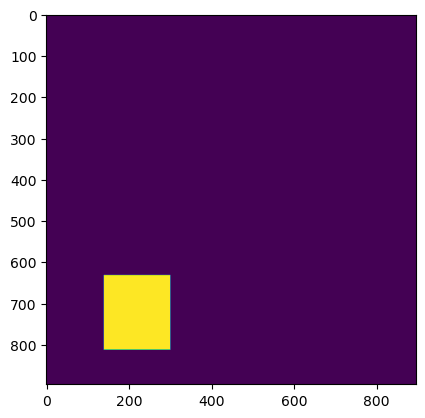

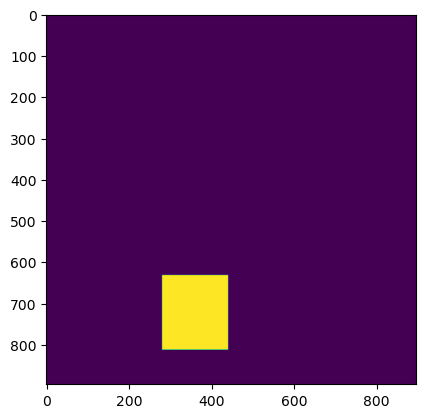

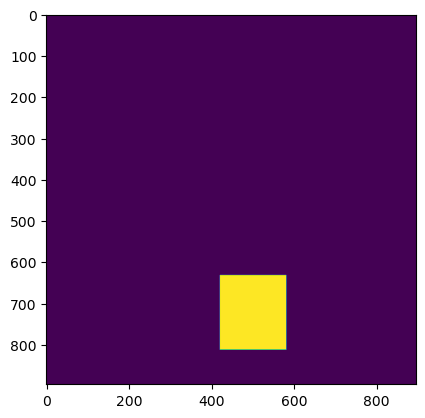

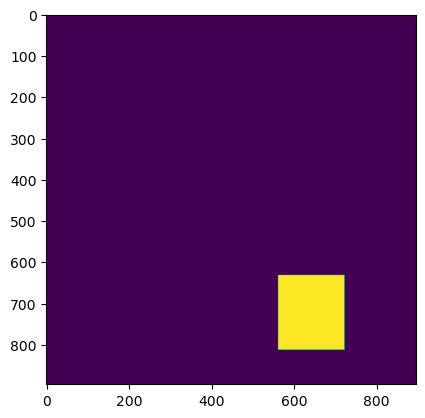

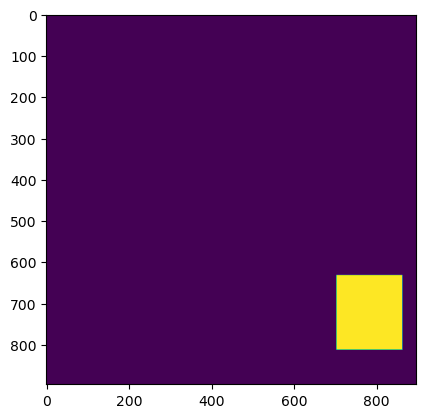

In [226]:
for i in range(30):
    plt.imshow(X[i,:,:,17])
    plt.show()

In [165]:
# Create a sample array
array = combined_data
blocks_list_comprehension = [
    array[i:i + w, j:j + w, :]
    for i in range(0, M - w + 1, stride)
    for j in range(0, N - w + 1, stride)
]
reshaped_array_list_comprehension = np.array(blocks_list_comprehension).reshape(A, w, w, C)

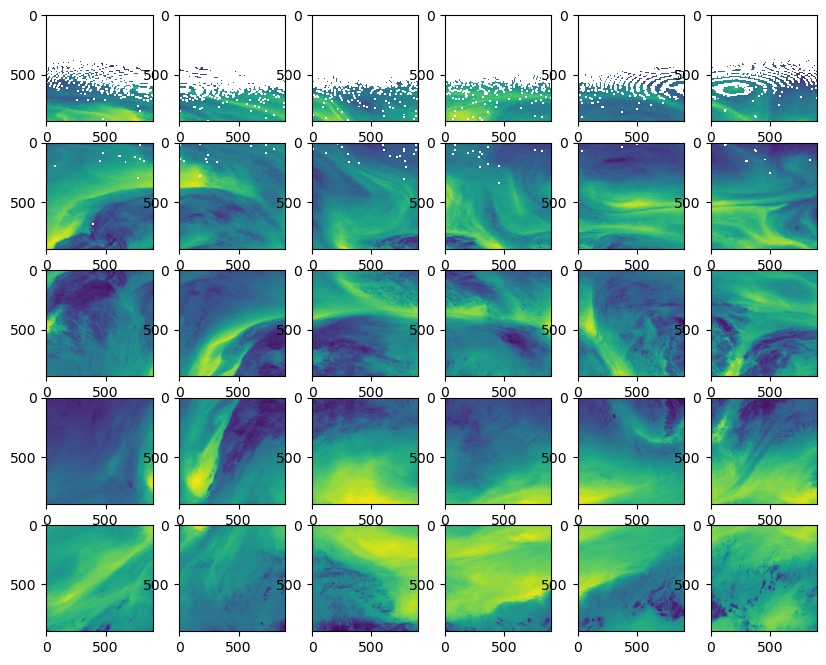

In [166]:
fig, ax = plt.subplots(5,6,figsize=(10,8))

k = 0
for i in range(5):
    for j in range(6):
        ax[i,j].imshow(reshaped_array_list_comprehension[k,:,:,7])
        k = k + 1
plt.show()


In [126]:
def process_chunk(args):
    

    return chunk_idx, chunk_X, chunk_y

def process_file(sat_data_dir, year, filename, input_vars, chunk_size, overlap, combined_mask_upscaled):
    

In [130]:
file_list = ['/home/ayadav7/data/goes_current/2018/334_12_g17.nc']

t1 = datetime.datetime.now()

for file in tqdm(file_list):
    year = file.split('/')[-2]
    filename = file.split('/')[-1]
    day = int(filename.split('_')[0])
    hour = int(filename.split('_')[1])
    ts, mo = day_of_year_to_timestep(day, hour, int(year))

    ld_files = [f for f in os.listdir(mask_data_dir) if year + str(mo).zfill(2) in f and 'nff' not in f]
    if len(ld_files) > 0:
        ld = xr.open_dataset(os.path.join(mask_data_dir, ld_files[0]))
        ld = ld.sel(latitude=slice(*lat_range), longitude=slice(*lon_range))
        data = ld['AR_binary_tag'][ts, :, :].values

        binary_mask = data.astype(float)
        sigma = 20
        smoothed_mask = ndimage.gaussian_filter(binary_mask, sigma=sigma)
        combined_mask = np.where(data == 1, 1, 2 * smoothed_mask)
        combined_mask = np.where(combined_mask >= 1, 1, combined_mask)

        combined_mask_upscaled = resize(combined_mask, input_shape, mode='reflect', anti_aliasing=True)

        sat = xr.open_dataset(os.path.join(sat_data_dir, year, filename))
        num_chunks_x = (sat.dims['lat'] - overlap) // (chunk_size[0] - overlap)
        num_chunks_y = (sat.dims['lon'] - overlap) // (chunk_size[1] - overlap)
        num_chunks = num_chunks_x * num_chunks_y
    
        X = np.empty((num_chunks, *chunk_size, len(input_vars) + 2))
        y = np.empty((num_chunks, *chunk_size, 1))
    
        downscaled_full_image = resize(sat[list(sat.data_vars)[7]].values, chunk_size, mode='reflect', anti_aliasing=True)
        downscaled_full_image = np.nan_to_num(downscaled_full_image, nan=0.0)
    
        # Preload the variable data to avoid multiple disk reads
        sat_data_values = [sat[var].values for var in input_vars]
    
        # Create a list of arguments for each chunk
        chunk_args = [(i, j, list(sat.data_vars), input_vars, chunk_size, overlap, combined_mask_upscaled, num_chunks_y, downscaled_full_image, sat_data_values)
                      for i in range(num_chunks_x) for j in range(num_chunks_y)]
        i, j, sat_data_vars, input_vars, chunk_size, overlap, combined_mask_upscaled, num_chunks_y, downscaled_full_image, sat_data_values = args
        print(f'starting {i}, {j} chunk......')
    
        # Calculate chunk boundaries
        start_row = i * (chunk_size[0] - overlap)
        start_col = j * (chunk_size[1] - overlap)
        end_row = start_row + chunk_size[0]
        end_col = start_col + chunk_size[1]
    
        chunk_idx = i * num_chunks_y + j
    
        chunk_X = np.empty((*chunk_size, len(input_vars) + 2))
        chunk_y = np.empty((*chunk_size, 1))
    
        for k, var in enumerate(input_vars):
            chunk_data = sat_data_values[k][start_row:end_row, start_col:end_col]
            chunk_data = np.nan_to_num(chunk_data, nan=0.0)
            chunk_X[:, :, k] = chunk_data
    
        chunk_X[:, :, len(input_vars)] = downscaled_full_image
        chunk_X[:, :, len(input_vars) + 1] = 1
    
        chunk_mask = combined_mask_upscaled[start_row:end_row, start_col:end_col]
        chunk_mask = np.nan_to_num(chunk_mask, nan=0.0)
        chunk_y[:, :, 0] = chunk_mask
    
        print(f'finishing {i}, {j} chunk......')
        print('----------------------------------')
    
        for chunk_idx, chunk_X, chunk_y in results:
            X[chunk_idx] = chunk_X
            y[chunk_idx] = chunk_y
    
        sat.close()  # Ensure the dataset is closed

        X, y = process_file(sat_data_dir, year, filename, input_vars, chunk_size, overlap, combined_mask_upscaled)

        # Save the processed chunks
        save_path_X = os.path.join(root_dir, save_dir, f"X_{year}_{filename}.npy")
        save_path_y = os.path.join(root_dir, save_dir, f"y_{year}_{filename}.npy")
        np.save(save_path_X, X)
        np.save(save_path_y, y)
    else:
        print(f'No labeled file found for {filename}')

print(f'Total time taken: {datetime.datetime.now()-t1}')

  0%|          | 0/1 [00:01<?, ?it/s]

(0, 0, ['M6C01', 'M6C02', 'M6C03', 'M6C04', 'M6C05', 'M6C06', 'M6C07', 'M6C08', 'M6C09', 'M6C10', 'M6C11', 'M6C12', 'M6C13', 'M6C14', 'M6C15', 'M6C16'], ['M6C01', 'M6C02', 'M6C03', 'M6C04', 'M6C05', 'M6C06', 'M6C07', 'M6C08', 'M6C09', 'M6C10', 'M6C11', 'M6C12', 'M6C13', 'M6C14', 'M6C15', 'M6C16'], (896, 896), 112, array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]]), 6, array([[0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       ...,
       [2.937499 , 2.9355915, 2.9293354, ..., 3.7195983, 3.700685 ,
        3.7051334],
       [2.8339546, 2.8521557, 2.839026 , ..., 3.7165864, 3.6965795,
       

In [132]:
sat_data_values

[array([[          nan,           nan,           nan, ...,           nan,
                   nan,           nan],
        [          nan,           nan,           nan, ...,           nan,
                   nan,           nan],
        [          nan,           nan,           nan, ...,           nan,
                   nan,           nan],
        ...,
        [5.0756454e-02, 5.0756454e-02, 5.0756454e-02, ..., 4.4716606e+01,
         4.4716606e+01, 4.6340820e+01],
        [5.0756454e-02, 5.0756454e-02, 5.0756454e-02, ..., 4.5528717e+01,
         5.0401352e+01, 5.2837669e+01],
        [5.0756454e-02, 5.0756454e-02, 5.0756454e-02, ..., 4.6340820e+01,
         4.3904503e+01, 4.7152931e+01]], dtype=float32),
 array([[           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,      

In [ ]:
for file in tqdm(file_list):
    year, filename = file
    try:
        day = int(filename.split('_')[0])
        hour = int(filename.split('_')[1])
        ts, mo = day_of_year_to_timestep(day, hour, int(year))

        ld_files = [f for f in os.listdir(mask_data_dir) if year + str(mo).zfill(2) in f and 'nff' not in f]
        if len(ld_files) > 0:
            ld = xr.open_dataset(os.path.join(mask_data_dir, ld_files[0]))
            ld = ld.sel(latitude=slice(*lat_range), longitude=slice(*lon_range))
            data = ld['AR_binary_tag'][ts, :, :].values

            binary_mask = data.astype(float)
            sigma = 20
            smoothed_mask = ndimage.gaussian_filter(binary_mask, sigma=sigma)
            combined_mask = np.where(data == 1, 1, 2 * smoothed_mask)
            combined_mask = np.where(combined_mask >= 1, 1, combined_mask)

            combined_mask_upscaled = resize(combined_mask, input_shape, mode='reflect', anti_aliasing=True)

            sat = xr.open_dataset(os.path.join(sat_data_dir, year, filename))
            X = np.empty((num_chunks, *chunk_size, num_channels))
            y = np.empty((num_chunks, *chunk_size, 1))

            for i in range(num_chunks_x):
                for j in range(num_chunks_y):
                    start_row = i * (chunk_size[0] - overlap)
                    start_col = j * (chunk_size[1] - overlap)
                    end_row = start_row + chunk_size[0]
                    end_col = start_col + chunk_size[1]

                    chunk_idx = i * num_chunks_y + j

                    for k, var in enumerate(input_vars):
                        sat_data = sat[var].values
                        chunk_data = sat_data[start_row:end_row, start_col:end_col]
                        chunk_data = np.nan_to_num(chunk_data, nan=0.0)
                        X[chunk_idx, :, :, k] = chunk_data

                    downscaled_full_image = resize(sat['M6C08'].values, chunk_size, mode='reflect', anti_aliasing=True)
                    downscaled_full_image = np.nan_to_num(downscaled_full_image, nan=0.0)

                    X[chunk_idx, :, :, len(input_vars)] = downscaled_full_image
                    X[chunk_idx, :, :, len(input_vars) + 1] = 1

                    chunk_mask = combined_mask_upscaled[start_row:end_row, start_col:end_col]
                    chunk_mask = np.nan_to_num(chunk_mask, nan=0.0)
                    y[chunk_idx, :, :, 0] = chunk_mask

            # Save the processed chunks
            save_path_X = os.path.join(save_dir, f"X_{year}_{filename}.npy")
            save_path_y = os.path.join(save_dir, f"y_{year}_{filename}.npy")
            np.save(save_path_X, X)
            np.save(save_path_y, y)
        else:
            print(f'No labeled file found for {filename}')
    except Exception as e:
        print(f"Error processing file {filename}: {e}")

## Check for available GOES data 

In [7]:
def get_month_from_day_of_year(day_of_year, year):
    date = datetime.datetime(year, 1, 1) + datetime.timedelta(days=day_of_year - 1)
    month = date.month
    return month

def day_of_year_to_timestep(day_of_year, hour, year):
    date = datetime.datetime(year, 1, 1) + datetime.timedelta(days=day_of_year - 1, hours=hour)
    start_of_month = datetime.datetime(year, date.month, 1)
    delta_hours = (date - start_of_month).total_seconds() / 3600
    time_step = int(delta_hours // 6)
    month = date.month  
    return time_step, month

In [8]:
import random

In [121]:
# lat_range=(90, 0)
# lon_range=(180, 270)

# for y in random.sample(os.listdir('goes2go'),4):
#     files = os.listdir(os.path.join('goes2go',y))
#     for f in random.sample(files,5):
#         day = int(f.split('_')[0])
#         hour = int(f.split('_')[1])
#         ts, mo = day_of_year_to_timestep(day, hour, int(y))
        
#         ld_files = [f for f in os.listdir('labeled_data_arhoades') if y+str(mo).zfill(2) in f and 'nff' not in f]
#         if len(ld_files)>0:
#             ld = xr.open_dataset(os.path.join('labeled_data_arhoades',ld_files[0]))
#             ld = ld.sel(latitude=slice(*lat_range), longitude=slice(*lon_range))
#         else:
#             print('No labeled file found')

#         lon = ld['longitude'].values
#         lat = ld['latitude'].values
#         lon_grid, lat_grid = np.meshgrid(lon, lat)
#         data = ld['AR_binary_tag'][ts, :, :].values

#         binary_mask = data.astype(float)
#         sigma = 20  # Standard deviation for Gaussian kernel
#         smoothed_mask = ndimage.gaussian_filter(binary_mask, sigma=sigma)
#         combined_mask = np.where(data == 1, 1, 2*smoothed_mask)
#         combined_mask = np.where(combined_mask >= 1, 1, combined_mask)

#         fig, axs = plt.subplots(1,4,figsize=(18,5),subplot_kw={'projection': ccrs.PlateCarree()})
#         for ax in axs:
#             ax.coastlines()
#             ax.add_feature(cfeature.BORDERS)        
#             ax.set_xlim(domain[0], domain[1])
#             ax.set_ylim(domain[2], domain[3])
#             ax.set_xticks(np.arange(domain[0], domain[1], 20), crs=ccrs.PlateCarree())
#             ax.set_yticks(np.arange(domain[2], domain[3], 20), crs=ccrs.PlateCarree())
#             ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x}°'))
#             ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y}°'))
            

#         # axs[0].pcolormesh(lon_grid, lat_grid, data, shading='auto')
#         axs[0].pcolormesh(lon_grid, lat_grid, combined_mask, shading='auto',cmap='viridis')
        
#         sat = xr.open_dataset(os.path.join('goes2go',y,f))
#         lon = sat['lon'].values
#         lat = np.flipud(sat['lat'].values)
#         factor = 4  # Change this factor to control the downsampling rate
#         lon_ds = lon[::factor]
#         lat_ds = lat[::factor]
        
#         for i, var in tqdm(enumerate(['M6C08','M6C09','M6C10']),total=4):
#             sat_data = sat[var].values
#             data_ds = sat_data[::factor, ::factor]
#             axs[i+1].pcolormesh(lon_ds, lat_ds, data_ds, transform=ccrs.PlateCarree())
#         print(data.shape, sat_data.shape)
#         plt.show()

# Preprocess and save data for the generator

In [122]:
# Define the function to preprocess and save data
def preprocess_and_save_data(sat_data_dir, mask_data_dir, input_vars, input_shape, chunk_size, overlap, lat_range, lon_range, save_dir):
    file_list = []
    for y in os.listdir(sat_data_dir):
        year_dir = os.path.join(sat_data_dir, y)
        if os.path.isdir(year_dir):
            for f in os.listdir(year_dir):
                file_list.append((y, f))

    num_chunks_x = (input_shape[0] - overlap) // (chunk_size[0] - overlap)
    num_chunks_y = (input_shape[1] - overlap) // (chunk_size[1] - overlap)
    num_chunks = num_chunks_x * num_chunks_y
    num_channels = len(input_vars) + 2  # Additional channels for downscaled full image and mask

    for file in tqdm(file_list):
        year, filename = file
        try:
            day = int(filename.split('_')[0])
            hour = int(filename.split('_')[1])
            ts, mo = day_of_year_to_timestep(day, hour, int(year))

            ld_files = [f for f in os.listdir(mask_data_dir) if year + str(mo).zfill(2) in f and 'nff' not in f]
            if len(ld_files) > 0:
                ld = xr.open_dataset(os.path.join(mask_data_dir, ld_files[0]))
                ld = ld.sel(latitude=slice(*lat_range), longitude=slice(*lon_range))
                data = ld['AR_binary_tag'][ts, :, :].values

                binary_mask = data.astype(float)
                sigma = 20
                smoothed_mask = ndimage.gaussian_filter(binary_mask, sigma=sigma)
                combined_mask = np.where(data == 1, 1, 2 * smoothed_mask)
                combined_mask = np.where(combined_mask >= 1, 1, combined_mask)

                combined_mask_upscaled = resize(combined_mask, input_shape, mode='reflect', anti_aliasing=True)

                sat = xr.open_dataset(os.path.join(sat_data_dir, year, filename))
                X = np.empty((num_chunks, *chunk_size, num_channels))
                y = np.empty((num_chunks, *chunk_size, 1))

                for i in range(num_chunks_x):
                    for j in range(num_chunks_y):
                        start_row = i * (chunk_size[0] - overlap)
                        start_col = j * (chunk_size[1] - overlap)
                        end_row = start_row + chunk_size[0]
                        end_col = start_col + chunk_size[1]

                        chunk_idx = i * num_chunks_y + j

                        for k, var in enumerate(input_vars):
                            sat_data = sat[var].values
                            chunk_data = sat_data[start_row:end_row, start_col:end_col]
                            chunk_data = np.nan_to_num(chunk_data, nan=0.0)
                            X[chunk_idx, :, :, k] = chunk_data

                        downscaled_full_image = resize(sat['M6C08'].values, chunk_size, mode='reflect', anti_aliasing=True)
                        downscaled_full_image = np.nan_to_num(downscaled_full_image, nan=0.0)

                        X[chunk_idx, :, :, len(input_vars)] = downscaled_full_image
                        X[chunk_idx, :, :, len(input_vars) + 1] = 1

                        chunk_mask = combined_mask_upscaled[start_row:end_row, start_col:end_col]
                        chunk_mask = np.nan_to_num(chunk_mask, nan=0.0)
                        y[chunk_idx, :, :, 0] = chunk_mask

                # Save the processed chunks
                save_path_X = os.path.join(save_dir, f"X_{year}_{filename}.npy")
                save_path_y = os.path.join(save_dir, f"y_{year}_{filename}.npy")
                np.save(save_path_X, X)
                np.save(save_path_y, y)
            else:
                print(f'No labeled file found for {filename}')
        except Exception as e:
            print(f"Error processing file {filename}: {e}")

# Define parameters
sat_data_dir = 'goes2go'
mask_data_dir = 'labeled_data_arhoades'
input_vars = [f'M6C{str(i).zfill(2)}' for i in range(1, 17)]
input_shape = (4441, 4996)
chunk_size = (896, 896)
overlap = 112
lat_range = (90, 0)
lon_range = (180, 270)
save_dir = 'preprocessed_data'

In [14]:
preprocess_and_save_data(sat_data_dir, mask_data_dir, input_vars, input_shape, chunk_size, overlap, lat_range, lon_range, save_dir)

  0%|          | 1/1747 [00:34<16:55:30, 34.90s/it]


KeyboardInterrupt: 

In [16]:
np.load('preprocessed_data/X_2018_271_0_g17.nc.npy').shape

(30, 896, 896, 18)

## Data Generator for the TF model

In [9]:
class ContextualChunkedSatelliteDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, sat_data_dir, mask_data_dir, batch_size, input_vars, input_shape, chunk_size, overlap, lat_range, lon_range, shuffle=True):
        self.sat_data_dir = sat_data_dir
        self.mask_data_dir = mask_data_dir
        self.batch_size = batch_size
        self.input_vars = input_vars
        self.input_shape = input_shape
        self.chunk_size = chunk_size
        self.overlap = overlap
        self.lat_range = lat_range
        self.lon_range = lon_range
        self.shuffle = shuffle
        self.file_list = self._get_file_list()
        self.on_epoch_end()

    def _get_file_list(self):
        files = []
        for y in os.listdir(self.sat_data_dir):
            year_dir = os.path.join(self.sat_data_dir, y)
            if os.path.isdir(year_dir):
                for f in os.listdir(year_dir):
                    files.append((y, f))
        return files

    def __len__(self):
        # Number of batches per epoch
        return int(np.floor(len(self.file_list) / self.batch_size))

    def __getitem__(self, index):
        # Generate one batch of data
        batch_indexes = self.indexes[index * self.batch_size:(index + 1) * self.batch_size]
        batch_files = [self.file_list[k] for k in batch_indexes]
        X, y = self._data_generation(batch_files)
        return X, y

    def on_epoch_end(self):
        self.indexes = np.arange(len(self.file_list))
        if self.shuffle:
            np.random.shuffle(self.indexes)

    def _data_generation(self, batch_files):
        # Generate data for a batch of files
        num_chunks_x = (self.input_shape[0] - self.overlap) // (self.chunk_size[0] - self.overlap)
        num_chunks_y = (self.input_shape[1] - self.overlap) // (self.chunk_size[1] - self.overlap)
        num_chunks = num_chunks_x * num_chunks_y
        num_channels = len(self.input_vars) + 2  # Additional channels for downscaled full image and mask

        # Initialize the arrays for the batch
        X = np.empty((self.batch_size * num_chunks, *self.chunk_size, num_channels))
        y = np.empty((self.batch_size * num_chunks, *self.chunk_size, 1))

        for i, file in enumerate(batch_files):
            year, filename = file
            try:
                day = int(filename.split('_')[0])
                hour = int(filename.split('_')[1])
                ts, mo = day_of_year_to_timestep(day, hour, int(year))
                
                ld_files = [f for f in os.listdir(self.mask_data_dir) if year + str(mo).zfill(2) in f and 'nff' not in f]
                if len(ld_files) > 0:
                    ld = xr.open_dataset(os.path.join(self.mask_data_dir, ld_files[0]))
                    ld = ld.sel(latitude=slice(*self.lat_range), longitude=slice(*self.lon_range))
                    data = ld['AR_binary_tag'][ts, :, :].values

                    binary_mask = data.astype(float)
                    sigma = 20  # Standard deviation for Gaussian kernel
                    smoothed_mask = ndimage.gaussian_filter(binary_mask, sigma=sigma)
                    combined_mask = np.where(data == 1, 1, 2 * smoothed_mask)
                    combined_mask = np.where(combined_mask >= 1, 1, combined_mask)

                    combined_mask_upscaled = resize(combined_mask, self.input_shape, mode='reflect', anti_aliasing=True)

                    sat = xr.open_dataset(os.path.join(self.sat_data_dir, year, filename))
                    for j in range(num_chunks_x):
                        for k in range(num_chunks_y):
                            start_row = j * (self.chunk_size[0] - self.overlap)
                            start_col = k * (self.chunk_size[1] - self.overlap)
                            end_row = start_row + self.chunk_size[0]
                            end_col = start_col + self.chunk_size[1]

                            chunk_idx = i * num_chunks + j * num_chunks_y + k

                            for l, var in enumerate(self.input_vars):
                                sat_data = sat[var].values
                                chunk_data = sat_data[start_row:end_row, start_col:end_col]
                                # Replace NaNs with zeros
                                chunk_data = np.nan_to_num(chunk_data, nan=0.0)
                                X[chunk_idx, :, :, l] = chunk_data

                            downscaled_full_image = resize(sat['M6C08'].values, self.chunk_size, mode='reflect', anti_aliasing=True)
                            downscaled_full_image = np.nan_to_num(downscaled_full_image, nan=0.0)

                            X[chunk_idx, :, :, len(self.input_vars)] = downscaled_full_image
                            X[chunk_idx, :, :, len(self.input_vars) + 1] = 1  # Full image mask

                            chunk_mask = combined_mask_upscaled[start_row:end_row, start_col:end_col]
                            chunk_mask = np.nan_to_num(chunk_mask, nan=0.0)
                            y[chunk_idx, :, :, 0] = chunk_mask
                else:
                    print(f'No labeled file found for {filename}')
            except Exception as e:
                print(f"Error processing file {filename}: {e}")
                X.fill(0)
                y.fill(0)

        return X, y

In [10]:
# Define parameters
sat_data_dir = 'goes2go'
mask_data_dir = 'labeled_data_arhoades'
batch_size = 1
input_vars = [f'M6C{str(i).zfill(2)}' for i in range(1, 17)]
input_shape = (4441, 4996)
chunk_size = (256,256)
overlap = 128
lat_range = (90, 0)
lon_range = (180, 270)
shuffle = True

# Create the data generator
train_generator = ContextualChunkedSatelliteDataGenerator(
    sat_data_dir, mask_data_dir, batch_size, input_vars, input_shape, chunk_size, overlap, lat_range, lon_range, shuffle
)

# Calculate total number of elements (samples)
total_samples = len(train_generator.file_list)
print(f"Total number of samples: {total_samples}")

# Calculate number of batches per epoch
num_batches_per_epoch = len(train_generator)
print(f"Number of batches per epoch: {num_batches_per_epoch}")

Total number of samples: 1747
Number of batches per epoch: 1747


In [20]:
X, y = train_generator[0]

KeyboardInterrupt: 

In [ ]:
X.shape

In [13]:
# fig, ax = plt.subplots(5,12,figsize=(11,5))

# k1 = 0
# k2 = 0
# for i in range(5):
#     for j1 in range(6):
#         ax[i][j1].imshow(X[k1,:,:,8])
#         k1 = k1 + 1
#         ax[i][j1].axis('off')
#     for j2 in range(6,12):
#         ax[i][j2].imshow(y[k2,:,:,0])
#         k2 = k2 + 1
#         ax[i][j2].axis('off')
# plt.show()

## Scratch U-Net

In [14]:
def unet_model(input_shape):
    inputs = Input(input_shape)

    # Encoder
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    c1 = BatchNormalization()(c1)
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(c1)
    c1 = BatchNormalization()(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    c2 = BatchNormalization()(c2)
    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(c2)
    c2 = BatchNormalization()(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(p2)
    c3 = BatchNormalization()(c3)
    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(c3)
    c3 = BatchNormalization()(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(256, (3, 3), activation='relu', padding='same')(p3)
    c4 = BatchNormalization()(c4)
    c4 = Conv2D(256, (3, 3), activation='relu', padding='same')(c4)
    c4 = BatchNormalization()(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(512, (3, 3), activation='relu', padding='same')(p4)
    c5 = BatchNormalization()(c5)
    c5 = Conv2D(512, (3, 3), activation='relu', padding='same')(c5)
    c5 = BatchNormalization()(c5)

    # Decoder
    u6 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(256, (3, 3), activation='relu', padding='same')(u6)
    c6 = BatchNormalization()(c6)
    c6 = Conv2D(256, (3, 3), activation='relu', padding='same')(c6)
    c6 = BatchNormalization()(c6)

    u7 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(128, (3, 3), activation='relu', padding='same')(u7)
    c7 = BatchNormalization()(c7)
    c7 = Conv2D(128, (3, 3), activation='relu', padding='same')(c7)
    c7 = BatchNormalization()(c7)

    u8 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(64, (3, 3), activation='relu', padding='same')(u8)
    c8 = BatchNormalization()(c8)
    c8 = Conv2D(64, (3, 3), activation='relu', padding='same')(c8)
    c8 = BatchNormalization()(c8)

    u9 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(32, (3, 3), activation='relu', padding='same')(u9)
    c9 = BatchNormalization()(c9)
    c9 = Conv2D(32, (3, 3), activation='relu', padding='same')(c9)
    c9 = BatchNormalization()(c9)

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)

    model = Model(inputs=[inputs], outputs=[outputs])
    return model

# Define input shape
input_shape = (896, 896, 18)

# Create the U-Net model
model = unet_model(input_shape)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='binary_crossentropy', metrics=['accuracy'])

# Summary of the model
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 896, 896, 18)]       0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 896, 896, 32)         5216      ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 896, 896, 32)         128       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 conv2d_1 (Conv2D)           (None, 896, 896, 32)         9248      ['batch_normalization[0][0

In [17]:
from tensorflow.keras.callbacks import Callback

class PrintBatchShape(Callback):
    def on_train_batch_begin(self, batch, logs=None):
        print(f"Batch {batch + 1} started")

In [19]:
print_batch_shape = PrintBatchShape()

history = model.fit(
    train_generator,
    epochs=10,  # Set the number of epochs as needed
    verbose=1,
    callbacks=[print_batch_shape]
)


KeyboardInterrupt



# Attention U-Net Model

In [113]:
import os
import sys
import random
import warnings
import numpy as np
from numpy import genfromtxt

from tensorflow.keras import backend as K
import tensorflow as tf

# Set random seeds for reproducibility
np.random.seed(1337)
tf.random.set_seed(1337)

warnings.filterwarnings('ignore', category=UserWarning, module='skimage')

# Dice coefficient function as the loss function
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2.0 * intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) + 1.0)

# Jacard coefficient
def jacard_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) - intersection + 1.0)

# Calculate loss value
def jacard_coef_loss(y_true, y_pred):
    return -jacard_coef(y_true, y_pred)

# Calculate loss value
def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

In [114]:
def Residual_CNN_block(x, size, dropout=0.0, batch_norm=True):
    axis = -1
    conv = Conv2D(size, (3, 3), padding='same')(x)
    if batch_norm:
        conv = BatchNormalization(axis=axis)(conv)
    conv = Activation('relu')(conv)
    conv = Conv2D(size, (3, 3), padding='same')(conv)
    if batch_norm:
        conv = BatchNormalization(axis=axis)(conv)
    conv = Activation('relu')(conv)
    conv = Conv2D(size, (3, 3), padding='same')(conv)
    if batch_norm:
        conv = BatchNormalization(axis=axis)(conv)
    conv = Activation('relu')(conv)
    return conv

class multiplication(Layer):
    def __init__(self, inter_channel=None, **kwargs):
        super(multiplication, self).__init__(**kwargs)
        self.inter_channel = inter_channel

    def build(self, input_shape=None):
        self.k = self.add_weight(name='k', shape=(1,), initializer='zeros', dtype='float32', trainable=True)

    def get_config(self):
        base_config = super(multiplication, self).get_config()
        config = {'inter_channel': self.inter_channel}
        return dict(list(base_config.items()) + list(config.items()))

    def call(self, inputs):
        g, x, x_query, phi_g, x_value = inputs[0], inputs[1], inputs[2], inputs[3], inputs[4]
        h, w, c = int(x.shape[1]), int(x.shape[2]), int(x.shape[3])
        x_query = K.reshape(x_query, shape=(-1, h * w, self.inter_channel // 4))
        phi_g = K.reshape(phi_g, shape=(-1, h * w, self.inter_channel // 4))
        x_value = K.reshape(x_value, shape=(-1, h * w, c))
        scale = dot([K.permute_dimensions(phi_g, (0, 2, 1)), x_query], axes=(1, 2))
        soft_scale = Activation('softmax')(scale)
        scaled_value = dot([K.permute_dimensions(soft_scale, (0, 2, 1)), K.permute_dimensions(x_value, (0, 2, 1))], axes=(1, 2))
        scaled_value = K.reshape(scaled_value, shape=(-1, h, w, c))
        customize_multi = self.k * scaled_value
        layero = add([customize_multi, x])
        concate = concatenate([layero, g], axis=3)
        return concate

    def compute_output_shape(self, input_shape):
        ll = list(input_shape)[1]
        return (None, ll[1], ll[1], ll[3] * 3)

    @staticmethod
    def get_custom_objects():
        return {'multiplication': multiplication}

def attention_up_and_concatenate(inputs):
    g, x = inputs[0], inputs[1]
    inter_channel = g.get_shape().as_list()[3]
    g = Conv2DTranspose(inter_channel, (2, 2), strides=[2, 2], padding='same')(g)
    x_query = Conv2D(inter_channel // 4, (1, 1), strides=[1, 1], data_format='channels_last')(x)
    phi_g = Conv2D(inter_channel // 4, (1, 1), strides=[1, 1], data_format='channels_last')(g)
    x_value = Conv2D(inter_channel // 2, (1, 1), strides=[1, 1], data_format='channels_last')(x)
    inputs = [g, x, x_query, phi_g, x_value]
    concate = multiplication(inter_channel)(inputs)
    return concate

class multiplication2(Layer):
    def __init__(self, inter_channel=None, **kwargs):
        super(multiplication2, self).__init__(**kwargs)
        self.inter_channel = inter_channel

    def build(self, input_shape=None):
        self.k = self.add_weight(name='k', shape=(1,), initializer='zeros', dtype='float32', trainable=True)

    def get_config(self):
        base_config = super(multiplication2, self).get_config()
        config = {'inter_channel': self.inter_channel}
        return dict(list(base_config.items()) + list(config.items()))

    def call(self, inputs):
        g, x, rate = inputs[0], inputs[1], inputs[2]
        scaled_value = multiply([x, rate])
        att_x = self.k * scaled_value
        att_x = add([att_x, x])
        concate = concatenate([att_x, g], axis=3)
        return concate

    def compute_output_shape(self, input_shape):
        ll = list(input_shape)[1]
        return (None, ll[1], ll[1], ll[3] * 2)

    @staticmethod
    def get_custom_objects():
        return {'multiplication2': multiplication2}

def attention_up_and_concatenate2(inputs):
    g, x = inputs[0], inputs[1]
    inter_channel = g.get_shape().as_list()[3]
    g = Conv2DTranspose(inter_channel // 2, (3, 3), strides=[2, 2], padding='same')(g)
    g = Conv2D(inter_channel // 2, (1, 1), strides=[1, 1], data_format='channels_last')(g)
    theta_x = Conv2D(inter_channel // 4, (1, 1), strides=[1, 1], data_format='channels_last')(x)
    phi_g = Conv2D(inter_channel // 4, (1, 1), strides=[1, 1], data_format='channels_last')(g)
    f = Activation('relu')(add([theta_x, phi_g]))
    psi_f = Conv2D(1, (1, 1), strides=[1, 1], data_format='channels_last')(f)
    rate = Activation('sigmoid')(psi_f)
    concate = multiplication2()([g, x, rate])
    return concate

def UNET_224(weights=None):
    inputs = Input((IMG_WIDTH, IMG_WIDTH, INPUT_CHANNELS))
    filters = 32
    last_dropout = 0.2
    # Convolution and pooling level 1
    conv_224 = Residual_CNN_block(inputs, filters)
    pool_112 = MaxPooling2D(pool_size=(2, 2))(conv_224)
    # Convolution and pooling level 2
    conv_112 = Residual_CNN_block(pool_112, 2 * filters)
    pool_56 = MaxPooling2D(pool_size=(2, 2))(conv_112)
    # Convolution and pooling level 3
    conv_56 = Residual_CNN_block(pool_56, 4 * filters)
    pool_28 = MaxPooling2D(pool_size=(2, 2))(conv_56)
    # Convolution and pooling level 4
    conv_28 = Residual_CNN_block(pool_28, 8 * filters)
    pool_14 = MaxPooling2D(pool_size=(2, 2))(conv_28)
    # Convolution and pooling level 5
    conv_14 = Residual_CNN_block(pool_14, 16 * filters)
    pool_7 = MaxPooling2D(pool_size=(2, 2))(conv_14)
    # Convolution and feature concatenation
    conv_7 = Residual_CNN_block(pool_7, 32 * filters)
    # Upsampling with convolution
    up_14 = attention_up_and_concatenate([conv_7, conv_14])
    up_conv_14 = Residual_CNN_block(up_14, 16 * filters)
    # Upsampling with convolution 2
    up_28 = attention_up_and_concatenate([up_conv_14, conv_28])
    up_conv_28 = Residual_CNN_block(up_28, 8 * filters)
    # Upsampling with convolution 3
    up_56 = attention_up_and_concatenate2([up_conv_28, conv_56])
    up_conv_56 = Residual_CNN_block(up_56, 4 * filters)
    # Upsampling with convolution 4
    up_112 = attention_up_and_concatenate2([up_conv_56, conv_112])
    up_conv_112 = Residual_CNN_block(up_112, 2 * filters)
    # Upsampling with convolution 5
    up_224 = attention_up_and_concatenate2([up_conv_112, conv_224])
    up_conv_224 = Residual_CNN_block(up_224, filters, dropout=last_dropout)
    # 1 dimensional convolution and generate probabilities from Sigmoid function
    conv_final = Conv2D(OUTPUT_MASK_CHANNELS, (1, 1))(up_conv_224)
    conv_final = Activation('sigmoid')(conv_final)
    # Generate model
    model = Model(inputs, conv_final, name="UNET_224")
    return model

In [117]:
patch_size = 512

IMG_WIDTH = patch_size
IMG_HEIGHT = patch_size
# Number of feature channels 
INPUT_CHANNELS = 18
# Number of output masks (1 in case you predict only one type of objects)
OUTPUT_MASK_CHANNELS = 1

In [118]:
u_net = UNET_224()
u_net.summary()

Model: "UNET_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_9 (InputLayer)        [(None, 512, 512, 18)]       0         []                            
                                                                                                  
 conv2d_56 (Conv2D)          (None, 512, 512, 32)         5216      ['input_9[0][0]']             
                                                                                                  
 batch_normalization_33 (Ba  (None, 512, 512, 32)         128       ['conv2d_56[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_40 (Activation)  (None, 512, 512, 32)         0         ['batch_normalization_3

In [119]:
# Register the custom layer/function
custom_objects = {'multiplication': multiplication, 'multiplication2': multiplication2, 'dice_coef_loss': dice_coef_loss, 'dice_coef': dice_coef}

# Load the pretrained model
model_path = 'models/attn_unet/models/model_aug_down_attention_U_net.h5'  # Update with your model path
pretrained_model = load_model(model_path, custom_objects=custom_objects)

# Freeze the layers
for layer in pretrained_model.layers:
    layer.trainable = False

In [133]:
# Generate a random input matrix of size (224, 224, 8)
random_input = np.zeros((1, 224, 224, 8))

# num_nan_values = int(random_input.size * 0.1)
# nan_indices = np.random.choice(random_input.size, num_nan_values, replace=False)
# random_input.flat[nan_indices] = np.nan

# Make a prediction using the pretrained model
prediction = pretrained_model.predict(random_input)

# Print the shape of the prediction
print(f"Prediction shape: {prediction.shape}")

1/1 [==============================] - 0s 292ms/step
Prediction shape: (1, 224, 224, 1)


Model: "downscale_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 896, 896, 18)]    0         
                                                                 
 conv1 (Conv2D)              (None, 448, 448, 32)      9248      
                                                                 
 bn1 (BatchNormalization)    (None, 448, 448, 32)      128       
                                                                 
 act1 (Activation)           (None, 448, 448, 32)      0         
                                                                 
 conv2 (Conv2D)              (None, 224, 224, 64)      32832     
                                                                 
 bn2 (BatchNormalization)    (None, 224, 224, 64)      256       
                                                                 
 act2 (Activation)           (None, 224, 224, 64)  

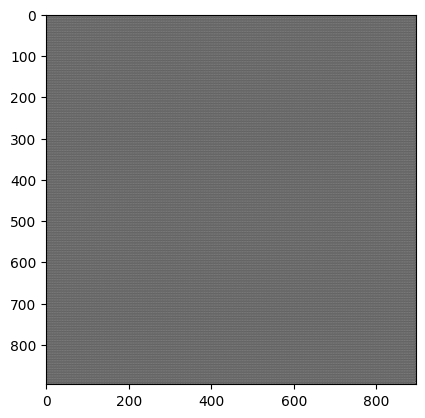

In [172]:
# Define the input layer with shape (896, 896, 18)
input_layer = Input(shape=(896, 896, 18), name='input_layer')

# Convolutional layer 1: Reduce spatial dimensions
x = Conv2D(32, (4, 4), strides=(2, 2), padding='same', name='conv1')(input_layer)
x = BatchNormalization(name='bn1')(x)
x = Activation('relu', name='act1')(x)

# Convolutional layer 2: Reduce spatial dimensions
x = Conv2D(64, (4, 4), strides=(2, 2), padding='same', name='conv2')(x)
x = BatchNormalization(name='bn2')(x)
x = Activation('relu', name='act2')(x)

# 1x1 Convolution to reduce channels to 8
x = Conv2D(8, (1, 1), padding='same', name='conv1x1')(x)
x = BatchNormalization(name='bn3')(x)
x = Activation('relu', name='act3')(x)

# The output shape should now be (224, 224, 8)
downscale_model = Model(inputs=input_layer, outputs=x, name='downscale_model')
downscale_model.summary()

# Generate a random input matrix of shape (1, 896, 896, 18)
# Assuming X is a matrix with shape (20, 896, 896, 18)
random_input = X[0, :, :, :][np.newaxis, :, :, :]

# Pass the random input through the downscale model
downscaled_output = downscale_model.predict(random_input)

# Ensure the output of the downscale model has the correct shape
print(f"Shape after downscaling: {downscaled_output.shape}")

# Make a prediction using the pretrained model
prediction = pretrained_model.predict(downscaled_output)

# Print the shape of the prediction
print(f"Prediction shape: {prediction.shape}")

# Upscaling the prediction to match the original input shape (896, 896, 1)
upscale_input = Input(shape=(224, 224, 1), name='upscale_input')
x = Conv2DTranspose(16, (4, 4), strides=(2, 2), padding='same', name='deconv1')(upscale_input)
x = BatchNormalization(name='de_bn1')(x)
x = Activation('relu', name='de_act1')(x)


x = Conv2DTranspose(1, (4, 4), strides=(2, 2), padding='same', name='deconv4')(x)
x = Activation('sigmoid', name='output_act')(x)

upscale_model = Model(inputs=upscale_input, outputs=x, name='upscale_model')
upscale_model.summary()

# Pass the prediction through the upscale model
upscaled_prediction = upscale_model.predict(prediction)

# Print the shape of the upscaled prediction
print(f"Upscaled prediction shape: {upscaled_prediction.shape}")

# Visualize the upscaled prediction
plt.imshow(upscaled_prediction[0, :, :, 0], cmap='gray')  # Assuming the upscaled prediction is a single-channel output
plt.show()

(array([4.00000e+00, 3.00000e+00, 5.07400e+04, 2.93899e+05, 3.04582e+05,
        1.03803e+05, 4.97820e+04, 2.00000e+00, 0.00000e+00, 1.00000e+00]),
 array([0.49985963, 0.4998934 , 0.49992719, 0.49996096, 0.49999475,
        0.50002849, 0.50006229, 0.50009608, 0.50012988, 0.50016361,
        0.50019741]),
 <BarContainer object of 10 artists>)

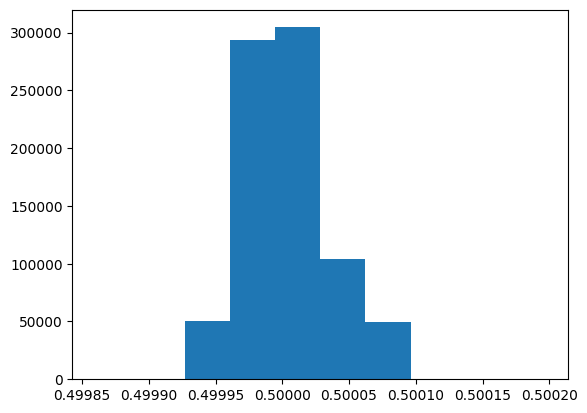

In [174]:
plt.hist(upscaled_prediction.flatten())

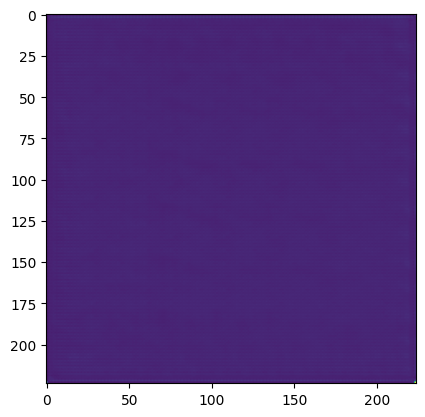

In [131]:
plt.imshow(prediction[0,:,:,0])

In [201]:
from tensorflow.keras.layers import Conv2D, Activation, Input
from tensorflow.keras.models import Model

# Define the input layer with shape (896, 896, 18)
input_layer = Input(shape=(896, 896, 18), name='new_input')

# Convolutional layer 1: Reduce spatial dimensions
x = Conv2D(32, (4, 4), strides=(2, 2), padding='same', name='conv1')(input_layer)
x = BatchNormalization(name='bn1')(x)
x = Activation('relu', name='act1')(x)

# Convolutional layer 2: Reduce spatial dimensions
x = Conv2D(64, (4, 4), strides=(2, 2), padding='same', name='conv2')(x)
x = BatchNormalization(name='bn2')(x)
x = Activation('relu', name='act2')(x)

# 1x1 Convolution to reduce channels to 8
x = Conv2D(8, (1, 1), padding='same', name='conv1x1')(x)
x = BatchNormalization(name='bn3')(x)
x = Activation('relu', name='act3')(x)

# The output shape should now be closer to (None, 224, 224, 8)
print(f"Shape after convolutional layers: {x.shape}")

# Feed the downscaled input into the pretrained model
pretrained_output = pretrained_model(x)

# Upscaling the prediction to match the original input shape (896, 896, 1)
x = Conv2DTranspose(16, (4, 4), strides=(2, 2), padding='same', name='deconv1')(pretrained_output)
x = BatchNormalization(name='de_bn1')(x)
x = Activation('relu', name='de_act1')(x)

x = Conv2DTranspose(8, (4, 4), strides=(2, 2), padding='same', name='deconv2')(x)
x = BatchNormalization(name='de_bn2')(x)
x = Activation('relu', name='de_act2')(x)

# Final output layer to get the desired output shape
final_output = Conv2D(1, (1, 1), activation='sigmoid', name='final_output')(x)

# Create the new model
new_model = Model(inputs=input_layer, outputs=final_output)

# Compile the new model
new_model.compile(optimizer=Adam(learning_rate=1e-4), loss='binary_crossentropy', metrics=['accuracy'])

# Summary of the new model
new_model.summary()

Shape after convolutional layers: (None, 224, 224, 8)
Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 new_input (InputLayer)      [(None, 896, 896, 18)]    0         
                                                                 
 conv1 (Conv2D)              (None, 448, 448, 32)      9248      
                                                                 
 bn1 (BatchNormalization)    (None, 448, 448, 32)      128       
                                                                 
 act1 (Activation)           (None, 448, 448, 32)      0         
                                                                 
 conv2 (Conv2D)              (None, 224, 224, 64)      32832     
                                                                 
 bn2 (BatchNormalization)    (None, 224, 224, 64)      256       
                                                                 
 act2

In [202]:
# Define parameters
sat_data_dir = 'goes2go'
mask_data_dir = 'labeled_data_arhoades'
batch_size = 1
input_vars = [f'M6C{str(i).zfill(2)}' for i in range(1, 17)]
input_shape = (4441, 4996)
chunk_size = (896, 896)
overlap = 112
lat_range = (90, 0)
lon_range = (180, 270)
shuffle = True

# Create the data generator
train_generator = ContextualChunkedSatelliteDataGenerator(
    sat_data_dir, mask_data_dir, batch_size, input_vars, input_shape, chunk_size, overlap, lat_range, lon_range, shuffle
)

# Calculate total number of elements (samples)
total_samples = len(train_generator.file_list)
print(f"Total number of samples: {total_samples}")

# Calculate number of batches per epoch
num_batches_per_epoch = len(train_generator)
print(f"Number of batches per epoch: {num_batches_per_epoch}")

Total number of samples: 1747
Number of batches per epoch: 1747


In [203]:
X, y = train_generator[0]
rand_sample = X[0,:,:,:][np.newaxis,:,:,:]
print(rand_sample.shape)
prediction = new_model.predict(rand_sample)

(1, 896, 896, 18)
1/1 [==============================] - 1s 1s/step


In [204]:
prediction.shape

(1, 896, 896, 1)

In [205]:
history = new_model.fit(
    train_generator,
    epochs=1,  # Set the number of epochs as needed
)

TypeError: in user code:

    File "/home/ayadav7/ayadav7/.conda/envs/ar-goes/lib/python3.10/site-packages/keras/src/engine/training.py", line 1401, in train_function  *
        return step_function(self, iterator)
    File "/home/ayadav7/ayadav7/.conda/envs/ar-goes/lib/python3.10/site-packages/keras/src/engine/training.py", line 1384, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/home/ayadav7/ayadav7/.conda/envs/ar-goes/lib/python3.10/site-packages/keras/src/engine/training.py", line 1373, in run_step  **
        outputs = model.train_step(data)
    File "/home/ayadav7/ayadav7/.conda/envs/ar-goes/lib/python3.10/site-packages/keras/src/engine/training.py", line 1150, in train_step
        y_pred = self(x, training=True)
    File "/home/ayadav7/ayadav7/.conda/envs/ar-goes/lib/python3.10/site-packages/keras/src/utils/traceback_utils.py", line 70, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "/tmp/__autograph_generated_filej65ncb0v.py", line 11, in tf__call
        (h, w, c) = (ag__.converted_call(ag__.ld(int), (ag__.ld(x).shape[1],), None, fscope), ag__.converted_call(ag__.ld(int), (ag__.ld(x).shape[2],), None, fscope), ag__.converted_call(ag__.ld(int), (ag__.ld(x).shape[3],), None, fscope))

    TypeError: Exception encountered when calling layer 'multiplication_1' (type multiplication).
    
    in user code:
    
        File "/tmp/ipykernel_1973244/342112818.py", line 32, in call  *
            h, w, c = int(x.shape[1]), int(x.shape[2]), int(x.shape[3])
    
        TypeError: int() argument must be a string, a bytes-like object or a real number, not 'NoneType'
    
    
    Call arguments received by layer 'multiplication_1' (type multiplication):
      • inputs=['tf.Tensor(shape=(None, None, None, 1024), dtype=float32)', 'tf.Tensor(shape=(None, None, None, 512), dtype=float32)', 'tf.Tensor(shape=(None, None, None, 256), dtype=float32)', 'tf.Tensor(shape=(None, None, None, 256), dtype=float32)', 'tf.Tensor(shape=(None, None, None, 512), dtype=float32)']


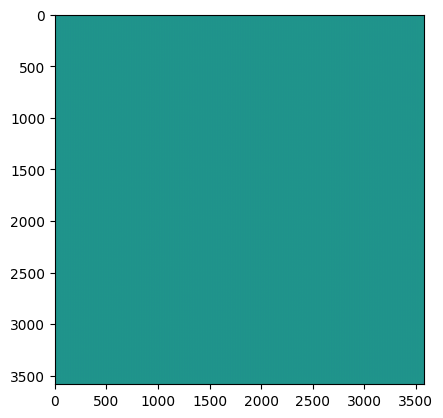

In [190]:
plt.imshow(prediction[0,:,:,0])

In [182]:
class DebugCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        print(f"Epoch {epoch+1} ended with logs: {logs}")

    def on_batch_end(self, batch, logs=None):
        print(f"Batch {batch+1} ended with logs: {logs}")

In [14]:
def unet_model(input_shape):
    inputs = layers.Input(shape=input_shape)

    # Encoder
    c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D((2, 2))(c1)

    c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D((2, 2))(c2)

    c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
    c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D((2, 2))(c3)

    c4 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(p3)
    c4 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(c4)
    p4 = layers.MaxPooling2D((2, 2))(c4)

    # Bottleneck
    c5 = layers.Conv2D(1024, (3, 3), activation='relu', padding='same')(p4)
    c5 = layers.Conv2D(1024, (3, 3), activation='relu', padding='same')(c5)

    # Decoder
    u6 = layers.UpSampling2D((2, 2))(c5)
    u6 = layers.Conv2D(512, (2, 2), activation='relu', padding='same')(u6)
    u6 = layers.concatenate([u6, c4])
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(c6)

    u7 = layers.UpSampling2D((2, 2))(c6)
    u7 = layers.Conv2D(256, (2, 2), activation='relu', padding='same')(u7)
    u7 = layers.concatenate([u7, c3])
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c7)

    u8 = layers.UpSampling2D((2, 2))(c7)
    u8 = layers.Conv2D(128, (2, 2), activation='relu', padding='same')(u8)
    u8 = layers.concatenate([u8, c2])
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c8)

    u9 = layers.UpSampling2D((2, 2))(c8)
    u9 = layers.Conv2D(64, (2, 2), activation='relu', padding='same')(u9)
    u9 = layers.concatenate([u9, c1])
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c9)

    outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(c9)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model

In [26]:
def transfer_unet_model(input_shape, num_input_channels, pre_trained_model='VGG16'):
    if pre_trained_model == 'VGG16':
        base_model = VGG16(weights='imagenet', include_top=False, input_shape=(input_shape[0], input_shape[1], 3))
    else:
        raise ValueError("Unsupported pre-trained model")

    # Freeze the encoder layers
    base_model.trainable = False

    # Input layer
    inputs = layers.Input(shape=(input_shape[0], input_shape[1], num_input_channels))
    
    # 1x1 convolution to reduce channels to 3
    conv_1x1 = layers.Conv2D(3, (1, 1), activation='relu', padding='same')(inputs)
    
    # Pass the reduced input through the pre-trained VGG16 model
    c1 = base_model.get_layer('block1_conv2')(conv_1x1)
    p1 = base_model.get_layer('block1_pool')(c1)

    c2 = base_model.get_layer('block2_conv2')(p1)
    p2 = base_model.get_layer('block2_pool')(c2)

    c3 = base_model.get_layer('block3_conv3')(p2)
    p3 = base_model.get_layer('block3_pool')(c3)

    c4 = base_model.get_layer('block4_conv3')(p3)
    p4 = base_model.get_layer('block4_pool')(c4)

    c5 = base_model.get_layer('block5_conv3')(p4)

    # Decoder
    u6 = layers.UpSampling2D((2, 2))(c5)
    u6 = layers.Conv2D(512, (2, 2), activation='relu', padding='same')(u6)
    u6 = layers.concatenate([u6, c4])
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(c6)

    u7 = layers.UpSampling2D((2, 2))(c6)
    u7 = layers.Conv2D(256, (2, 2), activation='relu', padding='same')(u7)
    u7 = layers.concatenate([u7, c3])
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c7)

    u8 = layers.UpSampling2D((2, 2))(c7)
    u8 = layers.Conv2D(128, (2, 2), activation='relu', padding='same')(u8)
    u8 = layers.concatenate([u8, c2])
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c8)

    u9 = layers.UpSampling2D((2, 2))(c8)
    u9 = layers.Conv2D(64, (2, 2), activation='relu', padding='same')(u9)
    u9 = layers.concatenate([u9, c1])
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c9)

    outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(c9)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model

In [27]:
input_shape = (512, 512, 18)  # Example input shape with 18 channels
model = transfer_unet_model(input_shape, num_input_channels=18, pre_trained_model='VGG16')
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

ValueError: Exception encountered when calling layer "block1_conv2" (type Conv2D).

Depth of input (3) is not a multiple of input depth of filter (64) for '{{node block1_conv2/Conv2D}} = Conv2D[T=DT_FLOAT, data_format="NHWC", dilations=[1, 1, 1, 1], explicit_paddings=[], padding="SAME", strides=[1, 1, 1, 1], use_cudnn_on_gpu=true](Placeholder, block1_conv2/Conv2D/ReadVariableOp)' with input shapes: [?,512,512,3], [3,3,64,64].

Call arguments received by layer "block1_conv2" (type Conv2D):
  • inputs=tf.Tensor(shape=(None, 512, 512, 3), dtype=float32)

In [18]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 512, 512, 18)]       0         []                            
                                                                                                  
 conv2d_23 (Conv2D)          (None, 512, 512, 64)         10432     ['input_2[0][0]']             
                                                                                                  
 conv2d_24 (Conv2D)          (None, 512, 512, 64)         36928     ['conv2d_23[0][0]']           
                                                                                                  
 max_pooling2d_4 (MaxPoolin  (None, 256, 256, 64)         0         ['conv2d_24[0][0]']           
 g2D)                                                                                       

In [19]:
# Define parameters
sat_data_dir = 'goes2go'
mask_data_dir = 'labeled_data_arhoades'
batch_size = 1
input_vars = [f'M6C{str(i).zfill(2)}' for i in range(1, 17)]
input_shape = (4441, 4996)
chunk_size = (512, 512)
overlap = 128
lat_range = (90, 0)
lon_range = (180, 270)
shuffle = True

# Create the data generator
train_generator = ContextualChunkedSatelliteDataGenerator(
    sat_data_dir, mask_data_dir, batch_size, input_vars, input_shape, chunk_size, overlap, lat_range, lon_range, shuffle
)

# Calculate total number of elements (samples)
total_samples = len(train_generator.file_list)
print(f"Total number of samples: {total_samples}")

# Calculate number of batches per epoch
num_batches_per_epoch = len(train_generator)
print(f"Number of batches per epoch: {num_batches_per_epoch}")

Total number of samples: 1747
Number of batches per epoch: 1747


In [ ]:
model.fit(train_generator, epochs=1)

In [ ]:
def predict_single_image(model, image_path, input_vars, input_shape, chunk_size, overlap):
    sat = xr.open_dataset(image_path)
    
    num_chunks_x = (input_shape[0] - overlap) // (chunk_size[0] - overlap)
    num_chunks_y = (input_shape[1] - overlap) // (chunk_size[1] - overlap)
    predicted_mask = np.zeros((input_shape[0], input_shape[1]))

    for i in range(num_chunks_x):
        for j in range(num_chunks_y):
            start_row = i * (chunk_size[0] - overlap)
            start_col = j * (chunk_size[1] - overlap)
            end_row = start_row + chunk_size[0]
            end_col = start_col + chunk_size[1]

            X_chunk = np.empty((1, chunk_size[0], chunk_size[1], len(input_vars)))

            for k, var in enumerate(input_vars):
                sat_data = sat[var].values
                chunk_data = sat_data[start_row:end_row, start_col:end_col]
                X_chunk[0, :, :, k] = chunk_data

            y_chunk_pred = model.predict(X_chunk)
            y_chunk_pred = y_chunk_pred.squeeze()

            predicted_mask[start_row:end_row, start_col:end_col] = y_chunk_pred

    return predicted_mask

In [63]:
t1 = datetime.datetime.now()
X, y = data_generator[0]
print('Data generator works!! It took {} seconds!'.format(datetime.datetime.now()-t1))

Data generator works!! It took 0:00:08.304102 seconds!


In [64]:
X.shape

(1, 512, 512, 18)

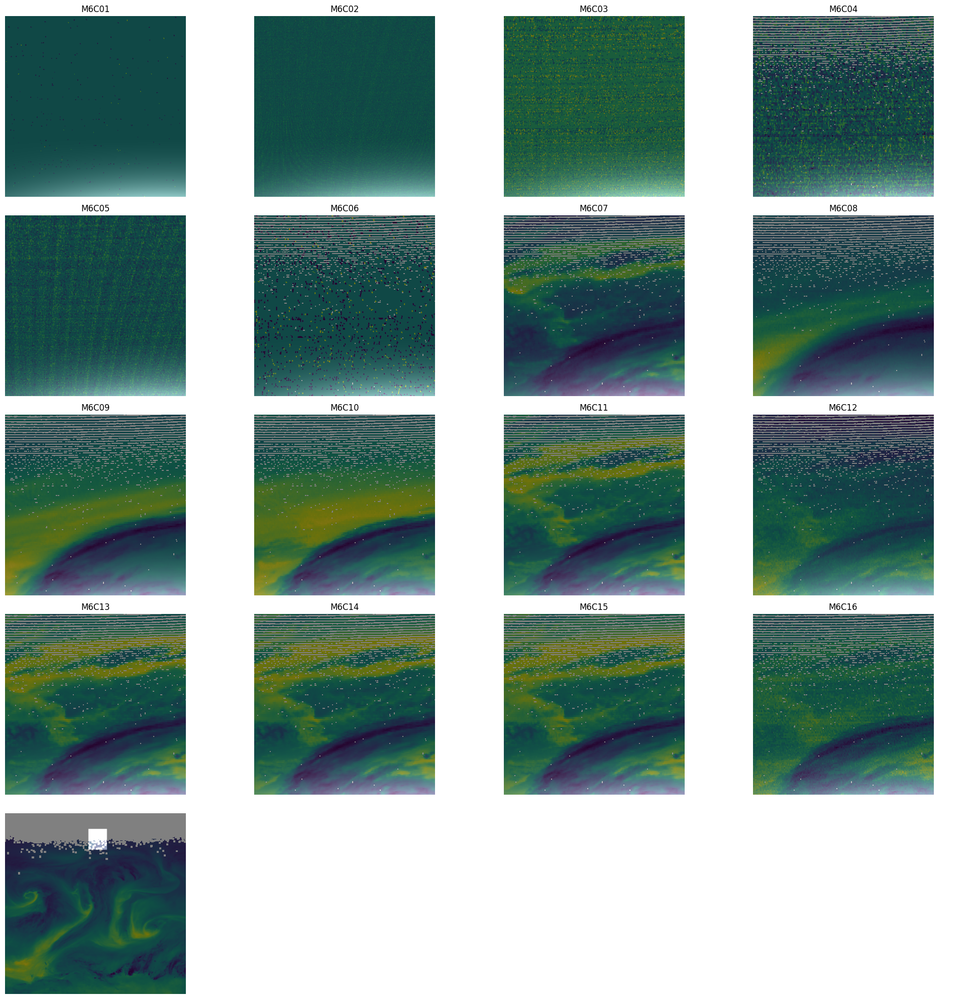

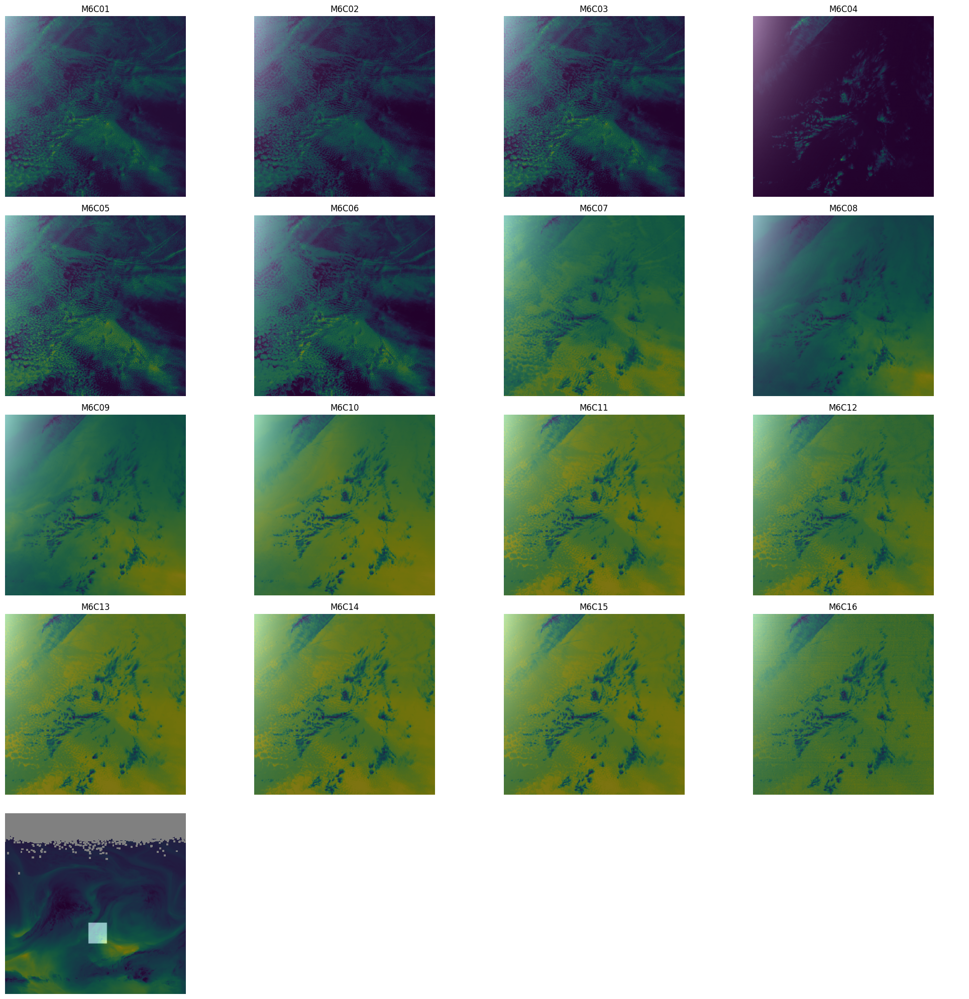

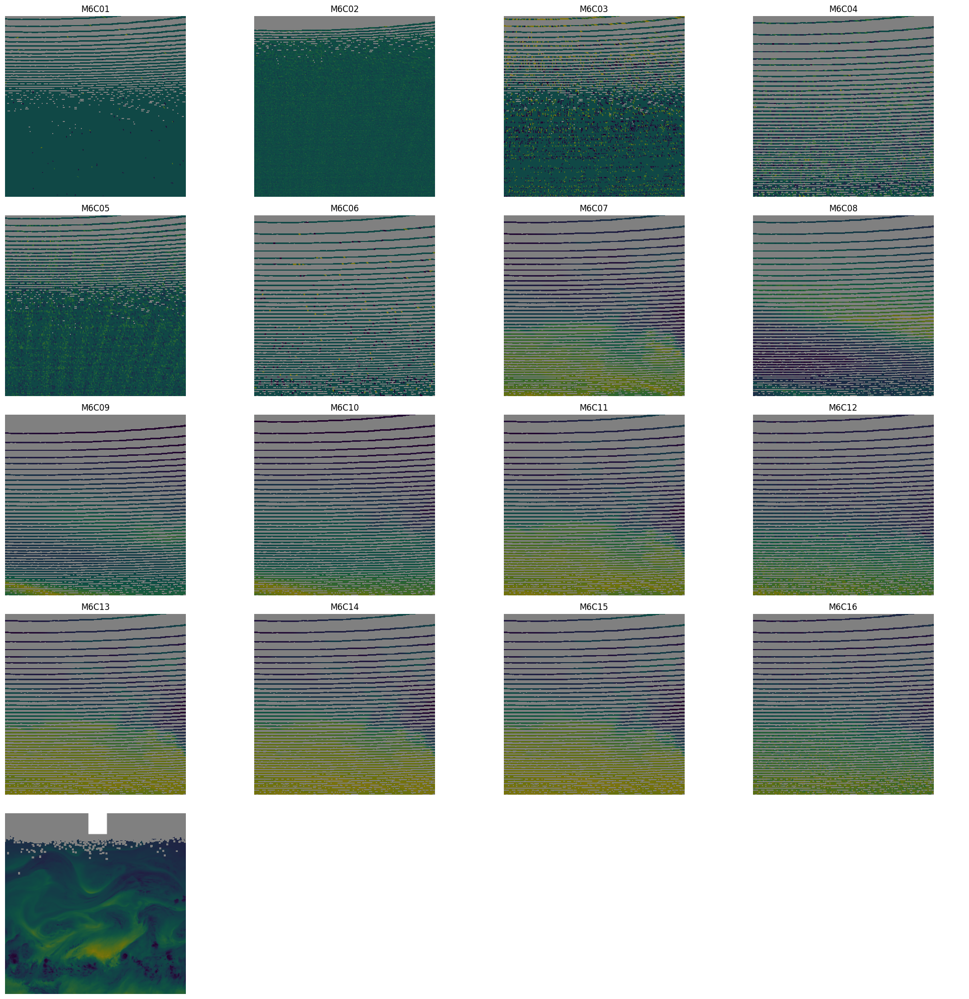

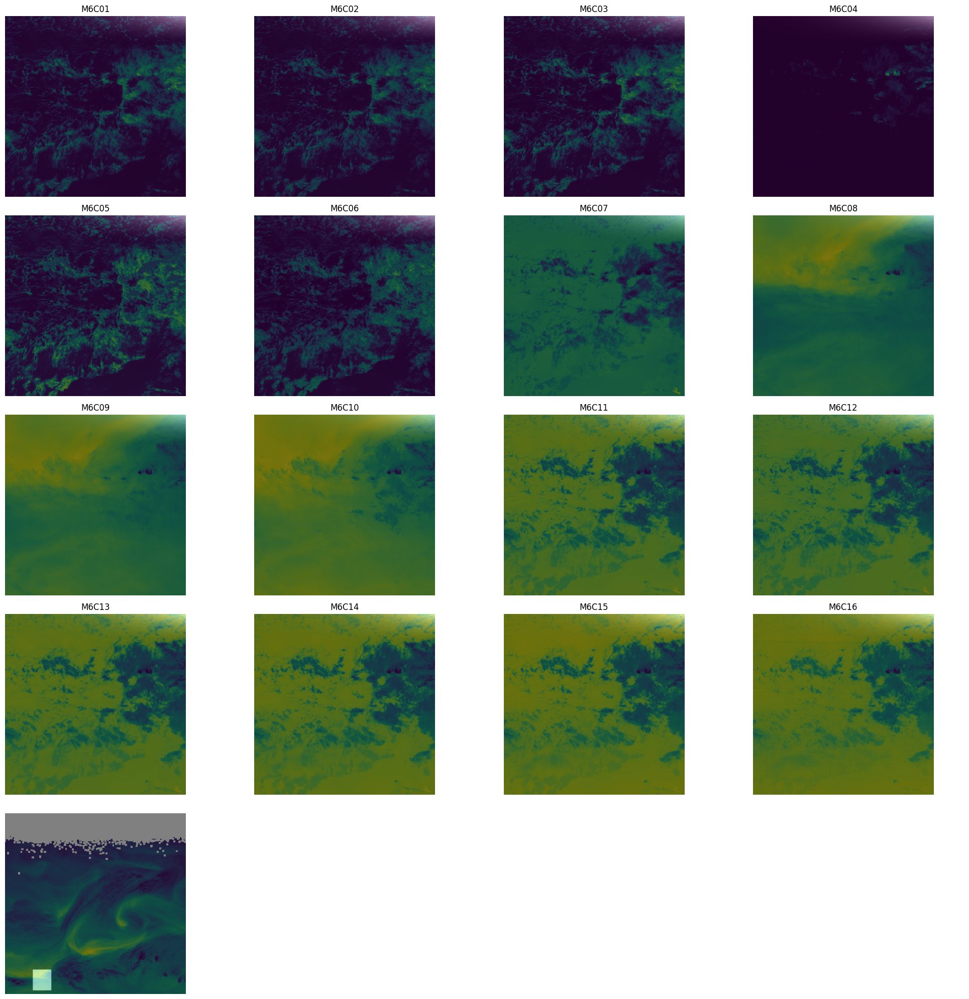

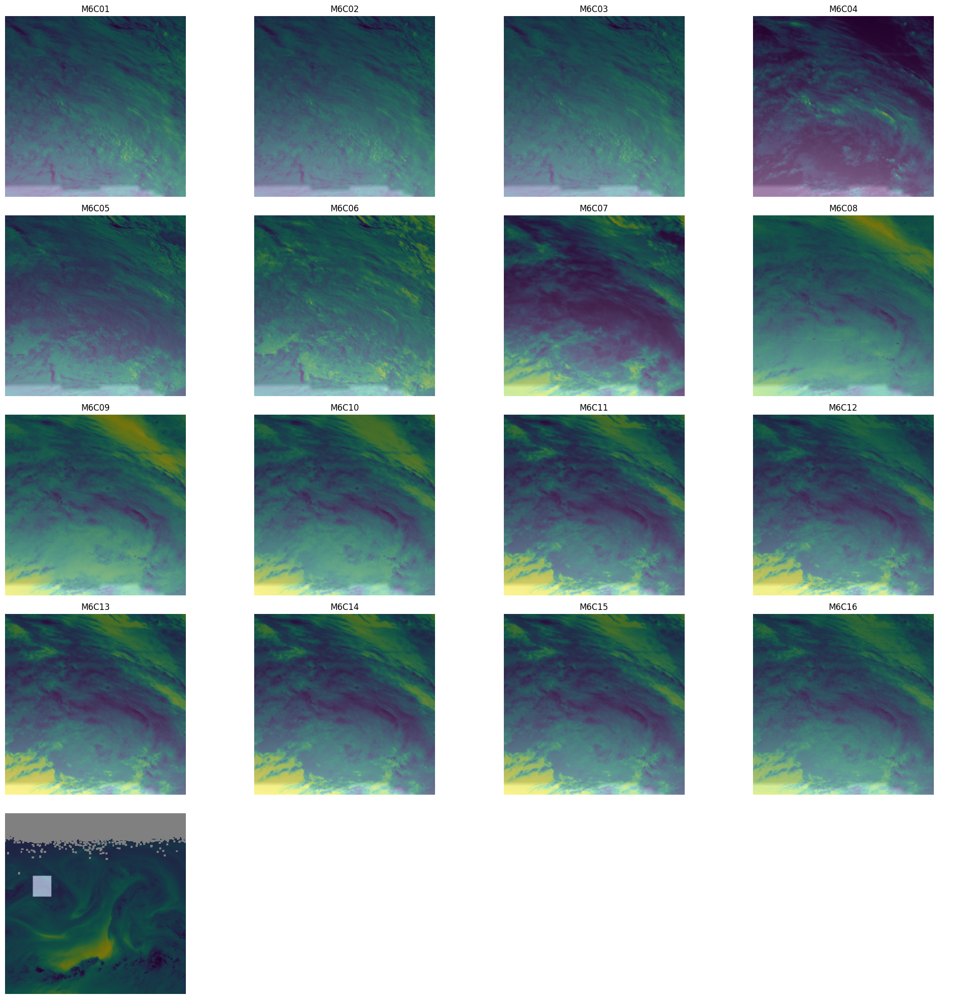

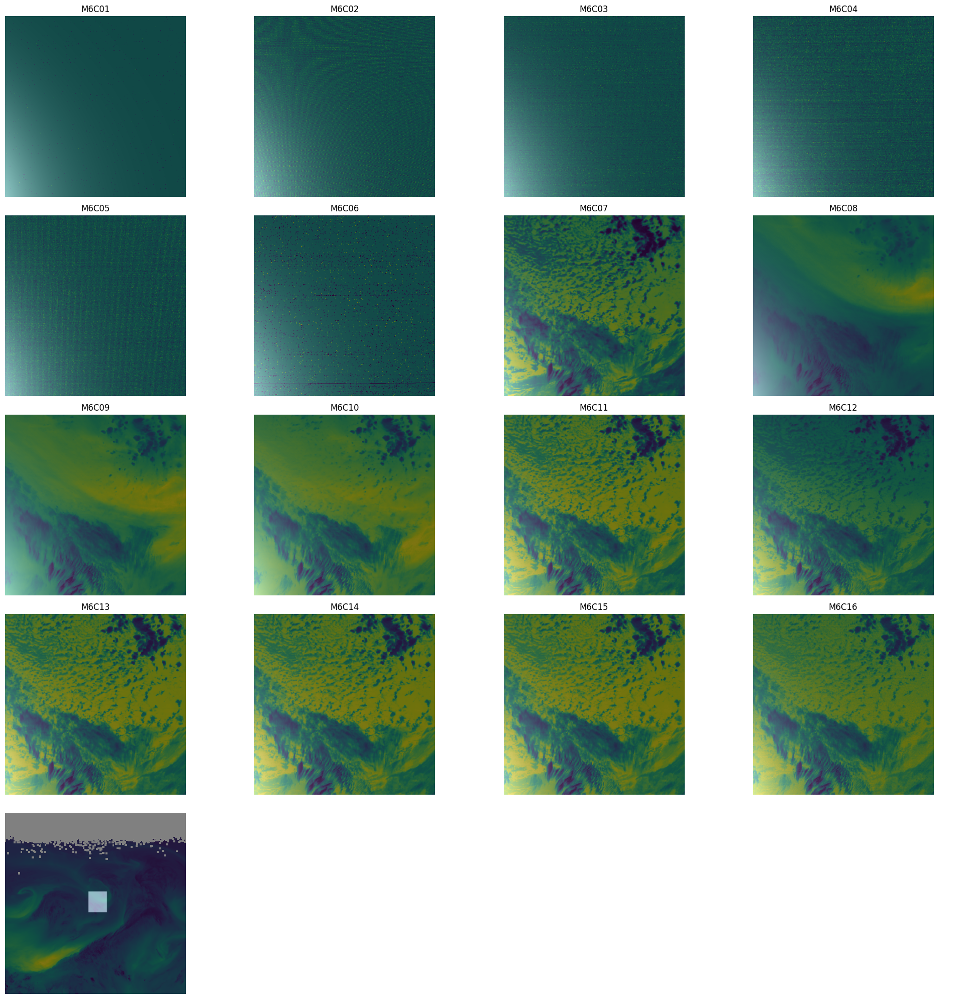

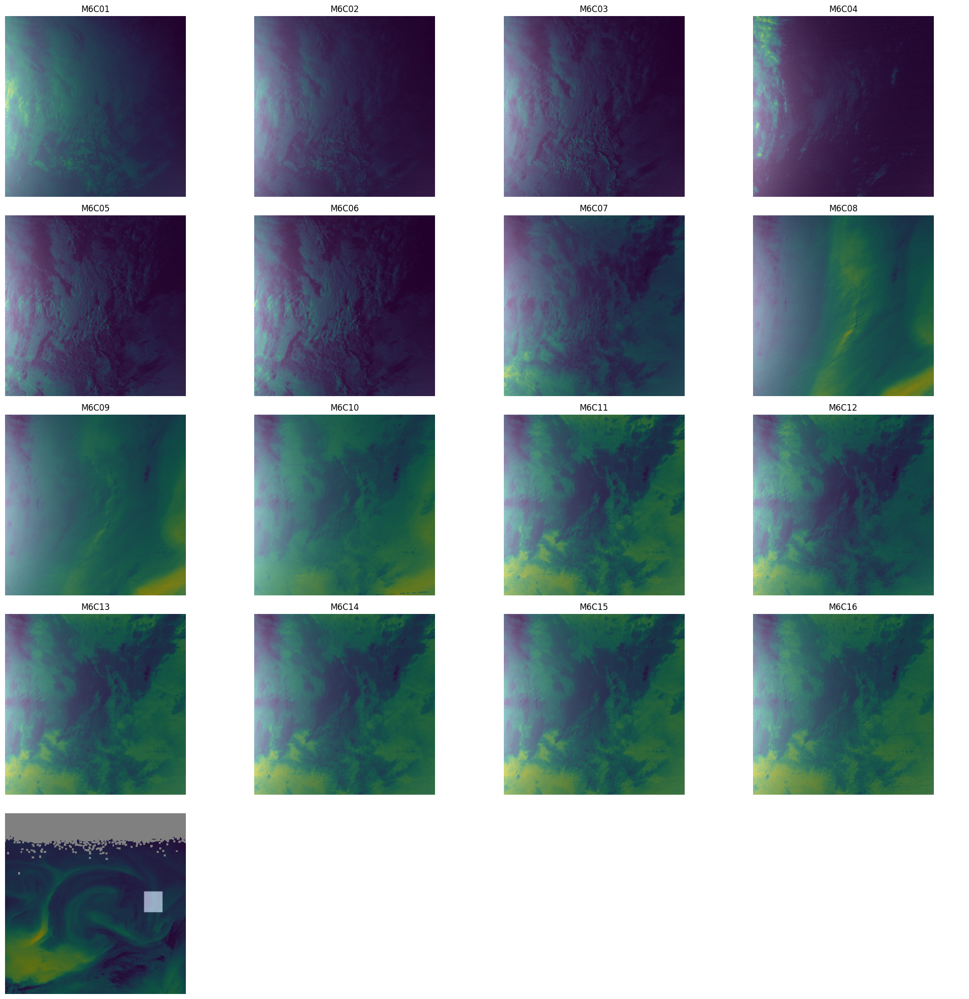

KeyboardInterrupt: 

In [69]:
for idx in range(10):
    X, y = data_generator[idx]

    # Plot the generated data and mask in a grid
    fig, axs = plt.subplots(5, 4, figsize=(20, 20))
    axs = axs.flatten()
    
    # Plot each satellite band with the overlaid mask
    for i, var in enumerate(input_vars):
        axs[i].imshow(X[0, :, :, i], cmap='viridis')
        axs[i].imshow(y[0, :, :, 0], cmap='gray', alpha=0.5)  # Overlay the mask with some transparency
        axs[i].set_title(var)
        axs[i].axis('off')
    
    axs[i+1].imshow(X[0, :, :, i+1], cmap='viridis')
    axs[i+1].imshow(X[0, :, :, i+2], cmap='gray', alpha=0.5)
    
    # Hide any remaining empty subplots
    for j in range(len(input_vars), len(axs)):
        axs[j].axis('off')
    
    plt.tight_layout()
    plt.show()

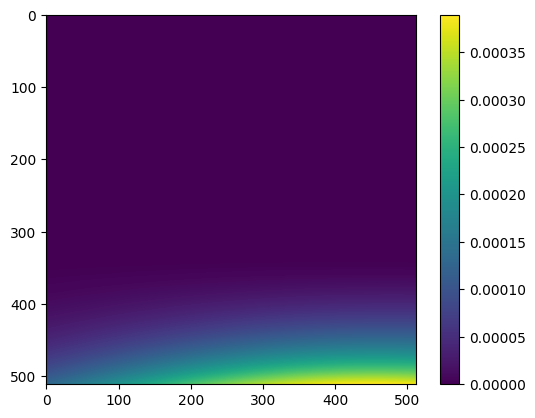

In [68]:
plt.imshow(y[0,:,:,0])
plt.colorbar()

In [ ]:
# Define a simple model (adjust architecture as needed)
input_shape_with_channels = (*input_shape, len(input_vars))
model = tf.keras.models.Sequential([
    tf.keras.layers.Input(shape=input_shape_with_channels),
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.UpSampling2D((2, 2)),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.UpSampling2D((2, 2)),
    tf.keras.layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')
])

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model using the generator
model.fit(data_generator, epochs=10)

## New GOES data reprojection

In [5]:
def goes_reproject(filename, domain, var):
  ds = GOES.open_dataset(filename)
  CMI, LonCen, LatCen = ds.image(var, lonlat='center', domain=domain)
  sat = ds.attribute('platform_ID')
  band = ds.variable('band_id').data[0]
  wl = ds.variable('band_wavelength').data[0]
  standard_name = CMI.standard_name
  units = CMI.units
  time_bounds = CMI.time_bounds
  LonCenCyl, LatCenCyl = GOES.create_gridmap(domain, PixResol=2.0)
  LonCorCyl, LatCorCyl = GOES.calculate_corners(LonCenCyl, LatCenCyl)
  Prj = pyproj.Proj('+proj=eqc +lat_ts=0 +lat_0=0 +lon_0=0 +x_0=0 +y_0=0 +a=6378.137 +b=6378.137 +units=km')
  AreaID = 'cyl'
  AreaName = 'cyl'
  ProjID = 'cyl'
  Proj4Args = '+proj=eqc +lat_ts=0 +lat_0=0 +lon_0=0 +x_0=0 +y_0=0 +a=6378.137 +b=6378.137 +units=km'

  ny, nx = LonCenCyl.data.shape
  SW = Prj(LonCenCyl.data.min(), LatCenCyl.data.min())
  NE = Prj(LonCenCyl.data.max(), LatCenCyl.data.max())
  area_extent = [SW[0], SW[1], NE[0], NE[1]]
  AreaDef = utils.get_area_def(AreaID, AreaName, ProjID, Proj4Args, nx, ny, area_extent)

  SwathDef = SwathDefinition(lons=LonCen.data, lats=LatCen.data)
  CMICyl = resample_nearest(SwathDef, CMI.data, AreaDef, radius_of_influence=6000,
                            fill_value=np.nan, epsilon=3, reduce_data=True)
  del CMI, LonCen, LatCen, SwathDef, LonCenCyl, LatCenCyl

  return LatCorCyl.data, LonCorCyl.data, CMICyl.data

In [31]:
band_counts = df.groupby(['year', 'day', 'hour']).size().reset_index(name='band_count')
band_counts = band_counts[band_counts['band_count']==16]
band_counts.shape

(3167, 4)

In [34]:
# Function to process each file
def process_file(filepath):
    t1 = datetime.datetime.now()
    LatCorCyl, LonCorCyl, CMICyl = goes_reproject(filepath, domain, 'Rad')
    print(f'Processing {filepath} took {datetime.datetime.now() - t1} sec')
    return LatCorCyl, LonCorCyl, CMICyl

In [62]:
domain = [-180, -90, 0, 80]

for idx, row in band_counts.iterrows():
    y = row['year']
    d = row['day']
    h = row['hour']

    nc_df = df[(df['year']==y)&(df['day']==d)&(df['hour']==h)]
    print(nc_df)

    ds_src = xr.open_dataset(nc_df.iloc[0]['filepath'])
    flag = 1

    for idx, row in nc_df.iterrows():
        filepath = row['filepath']
        band = row['band']

        if flag == 1:
            lat, lon, data = process_file(filepath)
            lat_1d = np.unique(lat)
            lat_1d = lat_1d[1:]
            lon_1d = np.unique(lon)
            lon_1d = lon_1d[1:]
            ds = xr.Dataset({
                            band: (('lat', 'lon'), data)
                        },
                        coords={
                            'lat': lat_1d,
                            'lon': lon_1d
                        }
                    )
            ds.attrs = ds_src.attrs.copy()
            del ds_src
            flag = 0
        else:
            lat, lon, data = process_file(filepath)
            ds[band] = (('lat', 'lon'), data)
    dirpath = os.path.join('goes2go',str(y))

    if not os.path.exists(dirpath):
        os.makedirs(dirpath)
        
    filename = str(d)+'_'+str(h)+'_g17.nc'
    ds.to_netcdf(os.path.join(dirpath,filename))
    del ds
    break

    year  day  hour   band                                           filepath
13  2018  269     0  M6C01  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
14  2018  269     0  M6C02  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
15  2018  269     0  M6C03  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
16  2018  269     0  M6C04  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
17  2018  269     0  M6C05  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
18  2018  269     0  M6C06  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
19  2018  269     0  M6C07  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
20  2018  269     0  M6C08  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
21  2018  269     0  M6C09  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
22  2018  269     0  M6C10  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
23  2018  269     0  M6C11  output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/20...
24  2018  269     0  M6C12  output_labeled_ARs/noaa-goes17/ABI-L

In [38]:
ds

<xarray.Dataset>
Dimensions:  (lat: 4441, lon: 4996)
Coordinates:
  * lat      (lat) float32 0.009007 0.02702 0.04504 ... 79.97 79.99 80.01
  * lon      (lon) float32 -180.0 -180.0 -180.0 -179.9 ... -90.03 -90.01 -89.99
Data variables: (12/16)
    M6C01    (lat, lon) float32 nan nan nan nan ... 0.05076 0.8629 0.8629
    M6C02    (lat, lon) float32 nan nan nan nan ... -0.3073 0.3271 0.009912
    M6C03    (lat, lon) float32 nan nan nan nan ... 0.02356 0.02356 0.02356
    M6C04    (lat, lon) float32 nan nan nan nan ... 0.004421 0.07515 0.1459
    M6C05    (lat, lon) float32 nan nan nan nan ... 0.005988 0.005988 0.005988
    M6C06    (lat, lon) float32 nan nan nan nan ... 0.001881 0.001881 0.001881
    ...       ...
    M6C11    (lat, lon) float32 nan nan nan nan nan ... 57.01 57.07 57.07 57.07
    M6C12    (lat, lon) float32 nan nan nan nan nan ... 55.08 55.08 55.02 55.08
    M6C13    (lat, lon) float32 nan nan nan nan nan ... 94.11 94.2 94.29 94.25
    M6C14    (lat, lon) float32 nan nan nan nan nan ... 106.5 106.6 106.6 106.5
    M6C15    (lat, lon) float32 nan nan nan nan nan ... 115.3 115.7 115.7 115.8
    M6C16    (lat, lon) float32 nan nan nan nan nan ... 101.1 102.5 100.7 102.7
Attributes: (12/29)
    naming_authority:          gov.nesdis.noaa
    Conventions:               CF-1.7
    Metadata_Conventions:      Unidata Dataset Discovery v1.0
    standard_name_vocabulary:  CF Standard Name Table (v25, 05 July 2013)
    institution:               DOC/NOAA/NESDIS > U.S. Department of Commerce,...
    project:                   GOES
    ...                        ...
    production_data_source:    Realtime
    timeline_id:               ABI Mode 6
    date_created:              2018-09-26T00:09:53.6Z
    time_coverage_start:       2018-09-26T00:00:22.4Z
    time_coverage_end:         2018-09-26T00:09:49.8Z
    id:                        fda783f3-7968-4cb2-82d7-50fa9f40f853

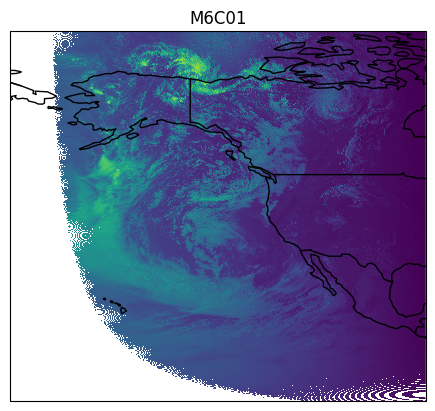

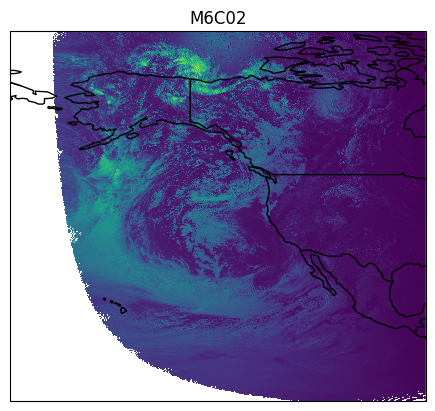

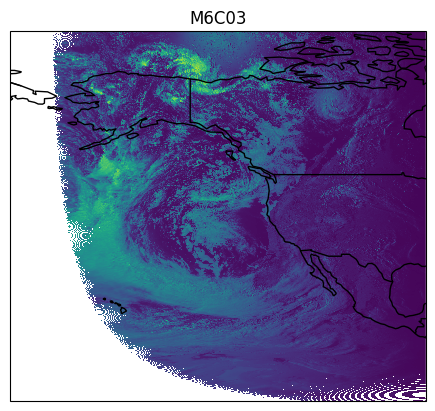

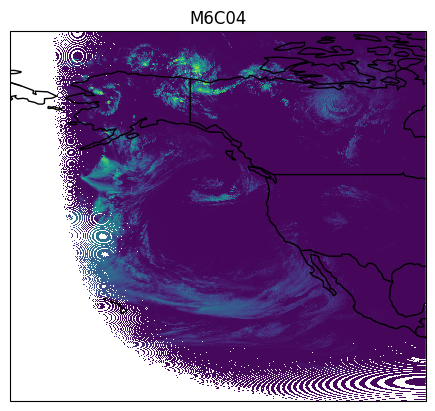

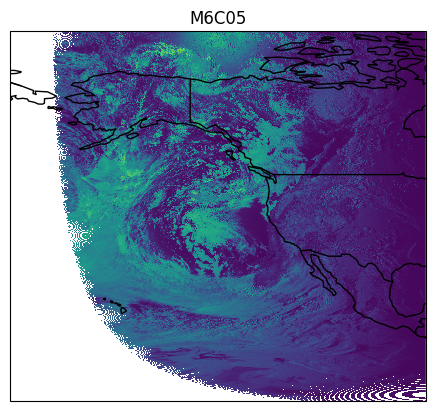

...

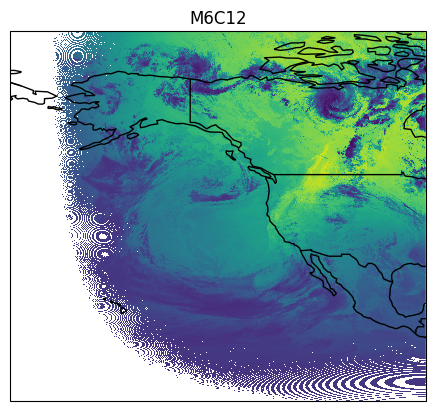

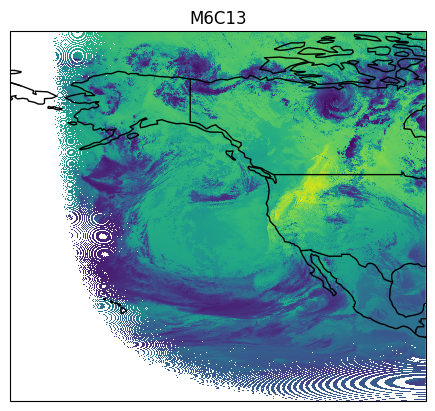

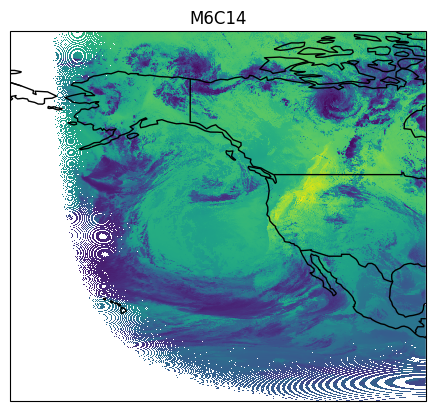

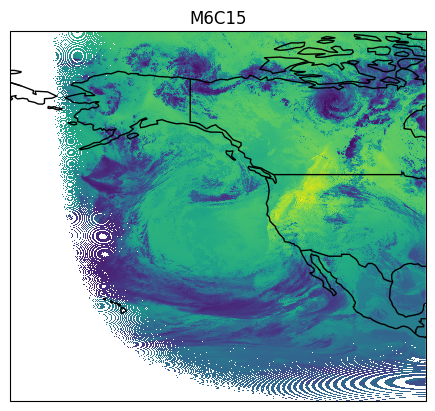

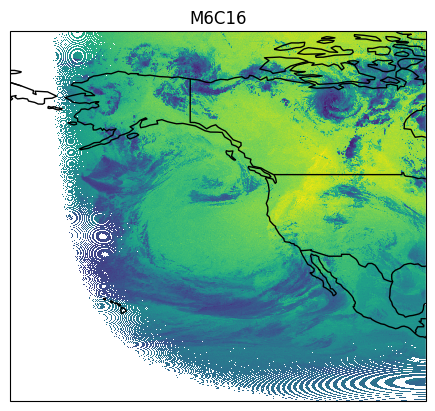

In [42]:
# Define the plotting function
def plot_variable(ax, var_data, lon, lat, title):
    mesh = ax.pcolormesh(lon, lat, var_data, transform=ccrs.PlateCarree(), cmap='viridis')
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS)
    ax.set_title(title)
    ax.set_xlim(domain[0], domain[1])
    ax.set_ylim(domain[2], domain[3])

# Set up the figure and axes

# Iterate over the variables and plot each one
for i, var_name in enumerate(ds.data_vars):
    var_data = ds[var_name].values
    lon = ds['lon'].values
    lat = ds['lat'].values
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
    plot_variable(ax, var_data, lon, lat, var_name)
    plt.show()

In [45]:
datetime.datetime.strptime('{}-{}'.format(y,d), '%Y-%j')

datetime.datetime(2018, 9, 26, 0, 0)

In [48]:
[f for f in os.listdir('labeled_data_arhoades') if '201809' in f]

['e5.oper.an.vinteg.ar_tags.ll025sc.2018090100_2018093023.nc',
 'e5.oper.an.vinteg.ar_tags_nff.ll025sc.2018090100_2018093023.nc']

In [57]:
ar = xr.open_dataset('labeled_data_arhoades/e5.oper.an.vinteg.ar_tags.ll025sc.2018090100_2018093023.nc')
lat_range=(90, 0)
lon_range=(180, 260)
ds_selected = ar.sel(latitude=slice(*lat_range), longitude=slice(*lon_range))

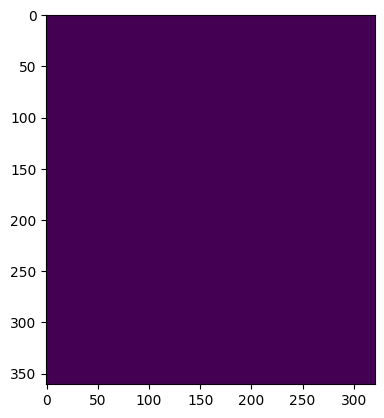

In [61]:
plt.imshow(ds_selected['AR_binary_tag'][60,:,:])

In [8]:
# Define the domain and the list of file paths

filepaths = df.loc[100,'filepath']  # Replace with your actual file paths



lat, lon, data = process_file(filepaths)

Processing output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/2018/270/06/OR_ABI-L1b-RadF-M6C08_G17_s20182700600226_e20182700609500_c20182700609538.nc took 0:00:10.243855 sec


In [23]:
ds_src = xr.open_dataset('output_labeled_ARs/noaa-goes17/ABI-L1b-RadF/2018/270/06/OR_ABI-L1b-RadF-M6C08_G17_s20182700600226_e20182700609500_c20182700609538.nc')

In [26]:
x = ds_src.attrs.copy()

In [18]:
lat_1d = np.unique(lat)
lat_1d = lat_1d[1:]
lon_1d = np.unique(lon)
lon_1d = lon_1d[1:]

print(lat_1d.shape, lon_1d.shape)

(4441,) (4996,)


In [17]:
lat.shape

(4442, 4997)

In [25]:
ds

<xarray.Dataset>
Dimensions:  (lat: 4441, lon: 4996)
Coordinates:
  * lat      (lat) float32 0.009007 0.02702 0.04504 ... 79.97 79.99 80.01
  * lon      (lon) float32 -180.0 -180.0 -180.0 -179.9 ... -90.03 -90.01 -89.99
Data variables:
    data     (lat, lon) float32 nan nan nan nan nan ... 5.012 5.012 5.012 5.004
Attributes: (12/29)
    naming_authority:          gov.nesdis.noaa
    Conventions:               CF-1.7
    Metadata_Conventions:      Unidata Dataset Discovery v1.0
    standard_name_vocabulary:  CF Standard Name Table (v25, 05 July 2013)
    institution:               DOC/NOAA/NESDIS > U.S. Department of Commerce,...
    project:                   GOES
    ...                        ...
    production_data_source:    Realtime
    timeline_id:               ABI Mode 6
    date_created:              2018-09-27T06:09:53.8Z
    time_coverage_start:       2018-09-27T06:00:22.6Z
    time_coverage_end:         2018-09-27T06:09:50.0Z
    id:                        8c68e26a-ced9-412f-81cc-62d6f04ae981

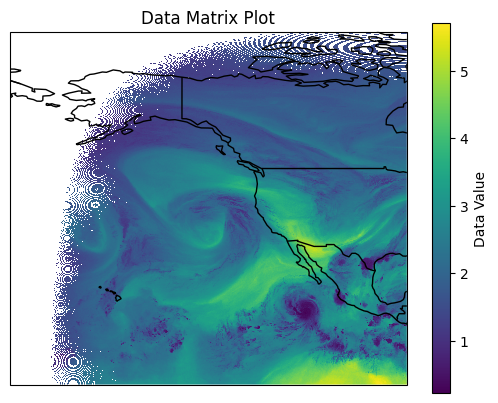

In [9]:


fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})

# Plot the data
mesh = ax.pcolormesh(lon, lat, data, transform=ccrs.PlateCarree(), cmap='viridis')

# Add coastlines and gridlines
ax.coastlines()
ax.add_feature(cfeature.BORDERS)

ax.set_xlim(domain[0], domain[1])
ax.set_ylim(domain[2], domain[3])

# Add a colorbar
cbar = plt.colorbar(mesh, ax=ax, orientation='vertical', pad=0.05)
cbar.set_label('Data Value')

# Set the title
plt.title('Data Matrix Plot')

# Show the plot
plt.show()